In [1]:
cd F:\PROJECTS\PROJECT_MONKEY SC-RNA SEQ\WORKPLACE\R\

F:\PROJECTS\PROJECT_MONKEY SC-RNA SEQ\WORKPLACE\R


G:\Miniconda3\envs\scvi-env\lib\site-packages\IPython\core\magics\osm.py:417: UserWarning: using dhist requires you to install the `pickleshare` library.
  self.shell.db['dhist'] = compress_dhist(dhist)[-100:]


In [2]:
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
import os
import sys
import scipy
import anndata


plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42
plt.rcParams["font.family"] = "Arial"

sc.set_figure_params(figsize=(4, 4))
sc.settings.set_figure_params(dpi = 150, color_map = 'RdPu', dpi_save = 600, vector_friendly = True, format = 'pdf')
palette = ['#fbbc04', '#199de5', '#cfe6d5']

In [3]:
def Barplot(which_var, adata, var='clusters', height=3, color = False):
    plotdata = pd.crosstab(adata.obs[var], adata.obs[which_var], normalize='index') * 100
    if 'category' in plotdata.index.dtype.name:
        plotdata.index.reorder_categories(adata.obs[var].cat.categories[::-1])

    if not color:
        ax1 = plotdata.plot.barh(stacked = True, edgecolor = 'none', zorder = 3, figsize = (6,height), fontsize = 14, grid = False)
    else:
        ax1 = plotdata.plot.barh(stacked = True, edgecolor = 'none', zorder = 3, figsize = (6,height), fontsize = 14, grid = False, color = color)
    ax1.set_title(which_var+' %')
    ax1.set_ylabel(var)
    horiz_offset = 1
    vert_offset = 1.
    ax1 = ax1.legend(bbox_to_anchor = (horiz_offset, vert_offset))
#     ax1.figure.savefig(str(sc.settings.figdir)+'/barplot_'+var+'_proportions_'+which_var+'.pdf', bbox_inches='tight',
#                        dpi=300, orientation='landscape', format= 'pdf', optimize=True)

In [4]:
import os
import tempfile
import scanpy as sc
import scvi
import seaborn as sns
import torch

In [5]:
scvi.settings.seed = 0
print("Last run with scvi-tools version:", scvi.__version__)

Seed set to 0


Last run with scvi-tools version: 1.1.2


In [6]:
import scanpy as sc
sc.set_figure_params()
mouse_sgn=sc.read_h5ad("Mm_sgn_python.h5ad")
mouse_sgn

AnnData object with n_obs × n_vars = 792 × 14530
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'integrated_snn_res.0.8', 'seurat_clusters', 'integrated_snn_res.1', 'integrated_snn_res.0.1', 'integrated_snn_res.0.2', 'integrated_snn_res.0.3', 'integrated_snn_res.0.4', 'integrated_snn_res.0.5', 'integrated_snn_res.0.6', 'integrated_snn_res.0.7', 'integrated_snn_res.0.9', 'subclass_label', 'cluster_label', 'seurat_clusters.new', 'celltype_species'
    var: 'name'
    obsm: 'X_pca', 'X_umap'

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


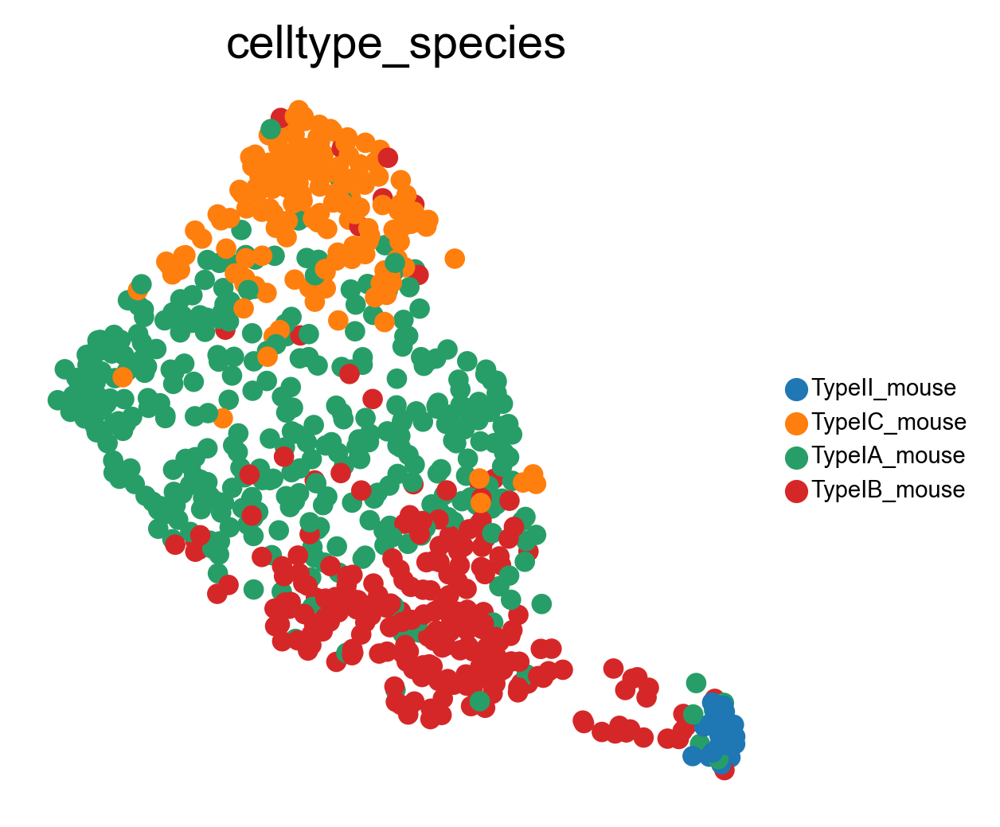

In [7]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.umap(mouse_sgn,color=['celltype_species'],frameon=False, legend_fontsize=7, 
           legend_fontoutline=False
          
          )

In [9]:
# Load dataset we want to transfer label to
macaque_sgn = sc.read("scvi_macaque_cell-type_final.h5ad")
print("macaque_sgn dims: {}".format(macaque_sgn.shape)) 

G:\Miniconda3\envs\scvi-env\lib\site-packages\anndata\__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


macaque_sgn dims: (36701, 15315)


In [10]:
#subset sgn population

adata_sgn1=macaque_sgn[macaque_sgn.obs['cell_type']=='TypeI_SGN']
adata_sgn1

View of AnnData object with n_obs × n_vars = 871 × 15315
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb', 'louvain', 'cluster', 'cluster2', 'cell_type2', 'cell_type3', 'batch', 'age', 'cluster3', 'cell_type', 'n_counts', 'leiden_res2', 'leiden_res5', 'cluster4', 'region'
    var: 'gene_ids', 'feature_types', 'Gene', 'genome-0', 'n_cells-0', 'm-0', 'v-0', 'n_obs-0', 'res-0', 'lp-0', 'lpa-0', 'qv-0', 'highly_variable-0', 'mt-0', 'n_cells_by_counts-0', 'mean_counts-0', 'pct_dropout_by_counts-0', 'total_counts-0', 'Mt-0', 'MT-0', 'HB-0', 'Hb-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'genome-1', 'n_cells-1', 'm-1', 'v-1', 'n_obs-1', 'res-1', 'lp-1', 'lpa-1', 'qv-1', 'highly_variable-1', 'n_cells_by_counts-1', 'mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts-1', 'MT-1', 'Hb-1',

In [11]:
adata_sgn2=macaque_sgn[macaque_sgn.obs['cell_type']=='TypeII_SGN']
adata_sgn2

View of AnnData object with n_obs × n_vars = 84 × 15315
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb', 'louvain', 'cluster', 'cluster2', 'cell_type2', 'cell_type3', 'batch', 'age', 'cluster3', 'cell_type', 'n_counts', 'leiden_res2', 'leiden_res5', 'cluster4', 'region'
    var: 'gene_ids', 'feature_types', 'Gene', 'genome-0', 'n_cells-0', 'm-0', 'v-0', 'n_obs-0', 'res-0', 'lp-0', 'lpa-0', 'qv-0', 'highly_variable-0', 'mt-0', 'n_cells_by_counts-0', 'mean_counts-0', 'pct_dropout_by_counts-0', 'total_counts-0', 'Mt-0', 'MT-0', 'HB-0', 'Hb-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'genome-1', 'n_cells-1', 'm-1', 'v-1', 'n_obs-1', 'res-1', 'lp-1', 'lpa-1', 'qv-1', 'highly_variable-1', 'n_cells_by_counts-1', 'mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts-1', 'MT-1', 'Hb-1', 

In [12]:
macaque_sgn=adata_sgn1.concatenate(adata_sgn2)
macaque_sgn

C:\Users\Dell\AppData\Local\Temp\ipykernel_5632\1094431786.py:1: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  macaque_sgn=adata_sgn1.concatenate(adata_sgn2)


AnnData object with n_obs × n_vars = 955 × 15315
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb', 'louvain', 'cluster', 'cluster2', 'cell_type2', 'cell_type3', 'batch', 'age', 'cluster3', 'cell_type', 'n_counts', 'leiden_res2', 'leiden_res5', 'cluster4', 'region'
    var: 'gene_ids', 'feature_types', 'Gene', 'highly_variable-2', 'mt-2', 'n_cells_by_counts-2', 'mean_counts-2', 'pct_dropout_by_counts-2', 'total_counts-2', 'means-2', 'dispersions-2', 'dispersions_norm-2', 'highly_variable-3', 'mt-3', 'n_cells_by_counts-3', 'mean_counts-3', 'pct_dropout_by_counts-3', 'total_counts-3', 'means-3', 'dispersions-3', 'dispersions_norm-3', 'highly_variable-4', 'mt-4', 'n_cells_by_counts-4', 'mean_counts-4', 'pct_dropout_by_counts-4', 'total_counts-4', 'means-4', 'dispersions-4', 'dispersions_norm-4', '

In [13]:
macaque_sgn.X = macaque_sgn.layers["counts"].copy()
sc.pp.normalize_total(macaque_sgn)
sc.pp.log1p(macaque_sgn)
macaque_sgn.layers["logcounts"] = macaque_sgn.X.copy()

In [240]:
mouse_sgn

AnnData object with n_obs × n_vars = 792 × 14530
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'integrated_snn_res.0.8', 'seurat_clusters', 'integrated_snn_res.1', 'integrated_snn_res.0.1', 'integrated_snn_res.0.2', 'integrated_snn_res.0.3', 'integrated_snn_res.0.4', 'integrated_snn_res.0.5', 'integrated_snn_res.0.6', 'integrated_snn_res.0.7', 'integrated_snn_res.0.9', 'subclass_label', 'cluster_label', 'seurat_clusters.new', 'celltype_species'
    var: 'name'
    uns: 'celltype_species_colors', 'log1p', 'rank_genes_groups'
    obsm: 'X_pca', 'X_umap'

In [241]:
mouse_sgn.layers["counts"]=mouse_sgn.X
mouse_sgn.X = mouse_sgn.layers["counts"].copy()
sc.pp.normalize_total(mouse_sgn)
sc.pp.log1p(mouse_sgn)
mouse_sgn.layers["logcounts"] = mouse_sgn.X.copy()

In [14]:
sc.pp.highly_variable_genes(macaque_sgn)
sc.tl.pca(macaque_sgn)
sc.pp.neighbors(macaque_sgn)
sc.tl.umap(macaque_sgn)
macaque_sgn

AnnData object with n_obs × n_vars = 955 × 15315
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb', 'louvain', 'cluster', 'cluster2', 'cell_type2', 'cell_type3', 'batch', 'age', 'cluster3', 'cell_type', 'n_counts', 'leiden_res2', 'leiden_res5', 'cluster4', 'region'
    var: 'gene_ids', 'feature_types', 'Gene', 'highly_variable-2', 'mt-2', 'n_cells_by_counts-2', 'mean_counts-2', 'pct_dropout_by_counts-2', 'total_counts-2', 'means-2', 'dispersions-2', 'dispersions_norm-2', 'highly_variable-3', 'mt-3', 'n_cells_by_counts-3', 'mean_counts-3', 'pct_dropout_by_counts-3', 'total_counts-3', 'means-3', 'dispersions-3', 'dispersions_norm-3', 'highly_variable-4', 'mt-4', 'n_cells_by_counts-4', 'mean_counts-4', 'pct_dropout_by_counts-4', 'total_counts-4', 'means-4', 'dispersions-4', 'dispersions_norm-4', '

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


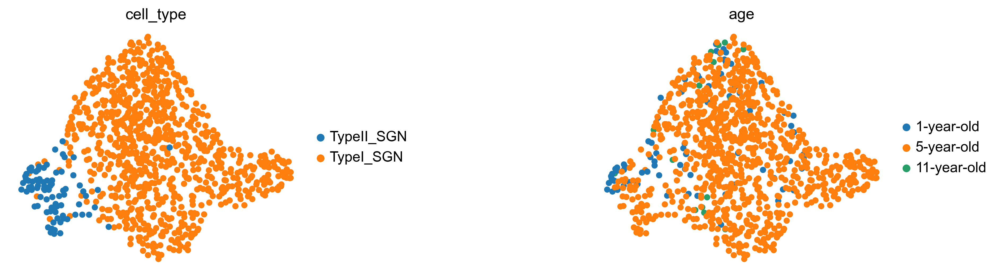

In [16]:
sc.pl.umap(macaque_sgn, color=['cell_type', 'age'], wspace=0.8)

In [26]:
sc.pp.highly_variable_genes(
    macaque_sgn, n_top_genes=10000, flavor="seurat_v3", batch_key='age'
)
macaque_sgn
macaque_sgn.var

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\preprocessing\_highly_variable_genes.py:64: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(


,gene_ids,feature_types,Gene,highly_variable-2,mt-2,n_cells_by_counts-2,mean_counts-2,pct_dropout_by_counts-2,total_counts-2,means-2,...,highly_variable-1,n_cells_by_counts-1,mean_counts-1,pct_dropout_by_counts-1,total_counts-1,MT-1,Hb-1,means-1,dispersions-1,dispersions_norm-1
PGBD2,PGBD2,Gene Expression,PGBD2,False,False,164,0.015832,98.499131,173.0,0.045741,...,False,147,0.001821,98.550582,18.467958,False,False,2.397476e-02,1.191768,-0.315746
ZNF692,ZNF692,Gene Expression,ZNF692,False,False,882,0.095818,91.928251,1047.0,0.257003,...,False,1879,0.032685,81.473082,331.489380,False,False,3.700584e-01,1.466549,-0.627443
ZNF672,ZNF672,Gene Expression,ZNF672,False,False,327,0.031573,97.007413,345.0,0.091892,...,False,658,0.009520,93.512128,96.548645,False,False,1.229118e-01,1.431418,0.194364
SH3BP5L,SH3BP5L,Gene Expression,SH3BP5L,False,False,505,0.051066,95.378420,558.0,0.134838,...,False,687,0.010443,93.226188,105.916557,False,False,1.345280e-01,1.522931,0.389156
LYPD8,LYPD8,Gene Expression,LYPD8,False,False,3,0.000275,99.972545,3.0,0.000624,...,False,1,0.000001,99.990140,0.013245,False,False,1.000000e-12,NaN,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
DNAJB13,DNAJB13,Gene Expression,DNAJB13,False,False,134,0.013544,98.773680,148.0,0.035387,...,False,143,0.001971,98.590022,19.991808,False,False,2.638702e-02,1.422720,0.175850
CNFN,CNFN,Gene Expression,CNFN,True,False,70,0.006589,99.359385,72.0,0.028500,...,True,128,0.002647,98.737922,26.846773,False,False,3.996741e-02,2.063750,1.540324
NCL,NCL,Gene Expression,NCL,False,False,1930,0.226595,82.337330,2476.0,0.553641,...,True,1652,0.032966,83.711300,334.341309,False,False,3.952503e-01,1.695232,0.753776
ZNF121,ZNF121,Gene Expression,ZNF121,False,False,63,0.005857,99.423447,64.0,0.016831,...,False,815,0.011990,91.964110,121.604202,False,False,1.506306e-01,1.367257,0.057792


In [27]:
n_batches = macaque_sgn.var["highly_variable_nbatches"].value_counts()
n_batches
adata_hvg = macaque_sgn[:, macaque_sgn.var["highly_variable"]].copy()
adata_hvg

AnnData object with n_obs × n_vars = 955 × 10000
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb', 'louvain', 'cluster', 'cluster2', 'cell_type2', 'cell_type3', 'batch', 'age', 'cluster3', 'cell_type', 'n_counts', 'leiden_res2', 'leiden_res5', 'cluster4', 'region'
    var: 'gene_ids', 'feature_types', 'Gene', 'highly_variable-2', 'mt-2', 'n_cells_by_counts-2', 'mean_counts-2', 'pct_dropout_by_counts-2', 'total_counts-2', 'means-2', 'dispersions-2', 'dispersions_norm-2', 'highly_variable-3', 'mt-3', 'n_cells_by_counts-3', 'mean_counts-3', 'pct_dropout_by_counts-3', 'total_counts-3', 'means-3', 'dispersions-3', 'dispersions_norm-3', 'highly_variable-4', 'mt-4', 'n_cells_by_counts-4', 'mean_counts-4', 'pct_dropout_by_counts-4', 'total_counts-4', 'means-4', 'dispersions-4', 'dispersions_norm-4', '

In [31]:
adata_scvi_sgn = adata_hvg.copy()
scvi.model.SCVI.setup_anndata(adata_scvi_sgn, layer="counts", batch_key='age')  
adata_scvi_sgn

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\data\fields\_base_field.py:64: UserWarning: adata.layers[counts] does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


AnnData object with n_obs × n_vars = 955 × 10000
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb', 'louvain', 'cluster', 'cluster2', 'cell_type2', 'cell_type3', 'batch', 'age', 'cluster3', 'cell_type', 'n_counts', 'leiden_res2', 'leiden_res5', 'cluster4', 'region', '_scvi_batch', '_scvi_labels'
    var: 'gene_ids', 'feature_types', 'Gene', 'highly_variable-2', 'mt-2', 'n_cells_by_counts-2', 'mean_counts-2', 'pct_dropout_by_counts-2', 'total_counts-2', 'means-2', 'dispersions-2', 'dispersions_norm-2', 'highly_variable-3', 'mt-3', 'n_cells_by_counts-3', 'mean_counts-3', 'pct_dropout_by_counts-3', 'total_counts-3', 'means-3', 'dispersions-3', 'dispersions_norm-3', 'highly_variable-4', 'mt-4', 'n_cells_by_counts-4', 'mean_counts-4', 'pct_dropout_by_counts-4', 'total_counts-4', 'means-4', 'dispersi

In [32]:
vae_sgn = scvi.model.SCVI(adata_scvi_sgn, n_layers=2, n_latent=30)
vae_sgn

SCVI model with the following parameters: 
n_hidden: 128, n_latent: 30, n_layers: 2, dropout_rate: 0.1, dispersion: gene, gene_likelihood: zinb, 
latent_distribution: normal.
Training status: Not Trained
Model's adata is minified?: False

In [33]:
vae_sgn.view_anndata_setup()

Anndata setup with scvi-tools version 1.1.2.

Setup via `SCVI.setup_anndata` with arguments:

{
│   'layer': 'counts',
│   'batch_key': 'age',
│   'labels_key': None,
│   'size_factor_key': None,
│   'categorical_covariate_keys': None,
│   'continuous_covariate_keys': None
}

         Summary Statistics         
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┓
┃     Summary Stat Key     ┃ Value ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━┩
│         n_batch          │   3   │
│         n_cells          │  955  │
│ n_extra_categorical_covs │   0   │
│ n_extra_continuous_covs  │   0   │
│         n_labels         │   1   │
│          n_vars          │ 10000 │
└──────────────────────────┴───────┘

               Data Registry                
┏━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Registry Key ┃    scvi-tools Location    ┃
┡━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      X       │  adata.layers['counts']   │
│    batch     │ adata.obs['_scvi_batch']  │
│    labels    │ adata.obs['_scvi_labels'] │
└──────────────┴───────────────────────────┘

                  batch State Registry                  
┏━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃ Source Location  ┃ Categories  ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['age'] │ 1-year-old  │          0          │
│                  │ 5-year-old  │          1          │
│                  │ 11-year-old │          2          │
└──────────────────┴─────────────┴─────────────────────┘

                     labels State Registry                      
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃      Source Location      ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['_scvi_labels'] │     0      │          0          │
└───────────────────────────┴────────────┴─────────────────────┘

In [34]:
max_epochs_scvi_sgn = np.min([round((20000 / adata_scvi_sgn.n_obs) * 400), 400])
max_epochs_scvi_sgn

400

In [35]:
vae_sgn.train()

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
G:\Miniconda3\envs\scvi-env\lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=47` in the `DataLoader` to improve performance.
G:\Miniconda3\envs\scvi-env\lib\site-packages\lightning\pytorch\loops\fit_loop.py:293: The number of training batches (7) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Epoch 1/400:   0%|                               | 0/400 [00:00<?, ?it/s]

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 2/400:   0%| | 1/400 [00:00<03:15,  2.04it/s, v_num=1, train_loss_s

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 3/400:   0%| | 2/400 [00:00<02:48,  2.36it/s, v_num=1, train_loss_s

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 4/400:   1%| | 3/400 [00:01<02:36,  2.53it/s, v_num=1, train_loss_s

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 5/400:   1%| | 4/400 [00:01<02:33,  2.58it/s, v_num=1, train_loss_s

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 6/400:   1%| | 5/400 [00:02<02:43,  2.42it/s, v_num=1, train_loss_s

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 7/400:   2%| | 6/400 [00:02<02:38,  2.49it/s, v_num=1, train_loss_s

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 8/400:   2%| | 7/400 [00:02<02:33,  2.56it/s, v_num=1, train_loss_s

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 9/400:   2%| | 8/400 [00:03<02:28,  2.63it/s, v_num=1, train_loss_s

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 10/400:   2%| | 9/400 [00:03<02:25,  2.69it/s, v_num=1, train_loss_

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 11/400:   2%| | 10/400 [00:03<02:22,  2.73it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 12/400:   3%| | 11/400 [00:04<02:21,  2.75it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 13/400:   3%| | 12/400 [00:04<02:19,  2.79it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 14/400:   3%| | 13/400 [00:04<02:20,  2.76it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 15/400:   4%| | 14/400 [00:05<02:23,  2.69it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 16/400:   4%| | 15/400 [00:05<02:21,  2.71it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 17/400:   4%| | 16/400 [00:06<02:26,  2.63it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 18/400:   4%| | 17/400 [00:06<02:23,  2.67it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 19/400:   4%| | 18/400 [00:06<02:22,  2.67it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 20/400:   5%| | 19/400 [00:07<02:21,  2.70it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 21/400:   5%| | 20/400 [00:07<02:18,  2.74it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 22/400:   5%| | 21/400 [00:07<02:16,  2.77it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 23/400:   6%| | 22/400 [00:08<02:17,  2.75it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 24/400:   6%| | 23/400 [00:08<02:15,  2.79it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 25/400:   6%| | 24/400 [00:08<02:14,  2.80it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 26/400:   6%| | 25/400 [00:09<02:12,  2.82it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 27/400:   6%| | 26/400 [00:09<02:11,  2.85it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 28/400:   7%| | 27/400 [00:10<02:10,  2.85it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 29/400:   7%| | 28/400 [00:10<02:13,  2.78it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 30/400:   7%| | 29/400 [00:10<02:11,  2.83it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 31/400:   8%| | 30/400 [00:11<02:10,  2.83it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 32/400:   8%| | 31/400 [00:11<02:11,  2.81it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 33/400:   8%| | 32/400 [00:11<02:09,  2.85it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 34/400:   8%| | 33/400 [00:12<02:08,  2.86it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 35/400:   8%| | 34/400 [00:12<02:07,  2.87it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 36/400:   9%| | 35/400 [00:12<02:07,  2.87it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 37/400:   9%| | 36/400 [00:13<02:07,  2.87it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 38/400:   9%| | 37/400 [00:13<02:05,  2.88it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 39/400:  10%| | 38/400 [00:13<02:04,  2.90it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 40/400:  10%| | 39/400 [00:14<02:04,  2.90it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 41/400:  10%| | 40/400 [00:14<02:03,  2.91it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 42/400:  10%| | 41/400 [00:14<02:03,  2.90it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 43/400:  10%| | 42/400 [00:15<02:04,  2.88it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 44/400:  11%| | 43/400 [00:15<02:07,  2.80it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 45/400:  11%| | 44/400 [00:15<02:06,  2.81it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 46/400:  11%| | 45/400 [00:16<02:09,  2.74it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 47/400:  12%| | 46/400 [00:16<02:06,  2.79it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 48/400:  12%| | 47/400 [00:17<02:05,  2.81it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 49/400:  12%| | 48/400 [00:17<02:04,  2.82it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 50/400:  12%| | 49/400 [00:17<02:03,  2.84it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 51/400:  12%|▏| 50/400 [00:18<02:03,  2.84it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 52/400:  13%|▏| 51/400 [00:18<02:02,  2.86it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 53/400:  13%|▏| 52/400 [00:18<02:00,  2.88it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 54/400:  13%|▏| 53/400 [00:19<02:00,  2.89it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 55/400:  14%|▏| 54/400 [00:19<01:59,  2.90it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 56/400:  14%|▏| 55/400 [00:19<01:59,  2.89it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 57/400:  14%|▏| 56/400 [00:20<01:59,  2.88it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 58/400:  14%|▏| 57/400 [00:20<02:02,  2.80it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 59/400:  14%|▏| 58/400 [00:20<02:00,  2.83it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 60/400:  15%|▏| 59/400 [00:21<02:00,  2.83it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 61/400:  15%|▏| 60/400 [00:21<01:59,  2.86it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 62/400:  15%|▏| 61/400 [00:21<01:57,  2.87it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 63/400:  16%|▏| 62/400 [00:22<01:58,  2.85it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 64/400:  16%|▏| 63/400 [00:22<01:57,  2.87it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 65/400:  16%|▏| 64/400 [00:23<01:57,  2.86it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 66/400:  16%|▏| 65/400 [00:23<01:57,  2.85it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 67/400:  16%|▏| 66/400 [00:23<01:58,  2.83it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 68/400:  17%|▏| 67/400 [00:24<01:56,  2.86it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 69/400:  17%|▏| 68/400 [00:24<01:55,  2.86it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 70/400:  17%|▏| 69/400 [00:24<01:54,  2.88it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 71/400:  18%|▏| 70/400 [00:25<01:54,  2.88it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 72/400:  18%|▏| 71/400 [00:25<01:54,  2.88it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 73/400:  18%|▏| 72/400 [00:25<01:57,  2.79it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 74/400:  18%|▏| 73/400 [00:26<01:56,  2.81it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 75/400:  18%|▏| 74/400 [00:26<01:58,  2.75it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 76/400:  19%|▏| 75/400 [00:26<02:02,  2.65it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 77/400:  19%|▏| 76/400 [00:27<02:12,  2.44it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 78/400:  19%|▏| 77/400 [00:27<02:07,  2.53it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 79/400:  20%|▏| 78/400 [00:28<02:03,  2.60it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 80/400:  20%|▏| 79/400 [00:28<01:59,  2.68it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 81/400:  20%|▏| 80/400 [00:28<01:56,  2.75it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 82/400:  20%|▏| 81/400 [00:29<01:54,  2.78it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 83/400:  20%|▏| 82/400 [00:29<01:53,  2.79it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 84/400:  21%|▏| 83/400 [00:29<01:53,  2.79it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 85/400:  21%|▏| 84/400 [00:30<01:52,  2.81it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 86/400:  21%|▏| 85/400 [00:30<01:51,  2.82it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 87/400:  22%|▏| 86/400 [00:31<01:54,  2.75it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 88/400:  22%|▏| 87/400 [00:31<01:53,  2.76it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 89/400:  22%|▏| 88/400 [00:31<01:51,  2.80it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 90/400:  22%|▏| 89/400 [00:32<01:49,  2.83it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 91/400:  22%|▏| 90/400 [00:32<01:50,  2.80it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 92/400:  23%|▏| 91/400 [00:32<01:49,  2.83it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 93/400:  23%|▏| 92/400 [00:33<01:48,  2.85it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 94/400:  23%|▏| 93/400 [00:33<01:48,  2.84it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 95/400:  24%|▏| 94/400 [00:33<01:46,  2.87it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 96/400:  24%|▏| 95/400 [00:34<01:46,  2.86it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 97/400:  24%|▏| 96/400 [00:34<01:45,  2.88it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 98/400:  24%|▏| 97/400 [00:34<01:44,  2.90it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 99/400:  24%|▏| 98/400 [00:35<01:44,  2.88it/s, v_num=1, train_loss

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 100/400:  25%|▏| 99/400 [00:35<01:44,  2.88it/s, v_num=1, train_los

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 101/400:  25%|▎| 100/400 [00:35<01:45,  2.85it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 102/400:  25%|▎| 101/400 [00:36<01:47,  2.79it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 103/400:  26%|▎| 102/400 [00:36<01:47,  2.77it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 104/400:  26%|▎| 103/400 [00:37<01:47,  2.77it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 105/400:  26%|▎| 104/400 [00:37<01:45,  2.79it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 106/400:  26%|▎| 105/400 [00:37<01:44,  2.82it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 107/400:  26%|▎| 106/400 [00:38<01:43,  2.84it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 108/400:  27%|▎| 107/400 [00:38<01:42,  2.85it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 109/400:  27%|▎| 108/400 [00:38<01:42,  2.85it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 110/400:  27%|▎| 109/400 [00:39<01:41,  2.86it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 111/400:  28%|▎| 110/400 [00:39<01:41,  2.87it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 112/400:  28%|▎| 111/400 [00:39<01:40,  2.87it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 113/400:  28%|▎| 112/400 [00:40<01:40,  2.88it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 114/400:  28%|▎| 113/400 [00:40<01:39,  2.87it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 115/400:  28%|▎| 114/400 [00:40<01:40,  2.84it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 116/400:  29%|▎| 115/400 [00:41<01:44,  2.74it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 117/400:  29%|▎| 116/400 [00:41<01:41,  2.79it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 118/400:  29%|▎| 117/400 [00:41<01:40,  2.82it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 119/400:  30%|▎| 118/400 [00:42<01:40,  2.81it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 120/400:  30%|▎| 119/400 [00:42<01:38,  2.84it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 121/400:  30%|▎| 120/400 [00:42<01:37,  2.87it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 122/400:  30%|▎| 121/400 [00:43<01:37,  2.86it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 123/400:  30%|▎| 122/400 [00:43<01:36,  2.88it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 124/400:  31%|▎| 123/400 [00:44<01:36,  2.87it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 125/400:  31%|▎| 124/400 [00:44<01:36,  2.87it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 126/400:  31%|▎| 125/400 [00:44<01:35,  2.88it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 127/400:  32%|▎| 126/400 [00:45<01:35,  2.87it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 128/400:  32%|▎| 127/400 [00:45<01:35,  2.85it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 129/400:  32%|▎| 128/400 [00:45<01:35,  2.86it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 130/400:  32%|▎| 129/400 [00:46<01:36,  2.80it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 131/400:  32%|▎| 130/400 [00:46<01:36,  2.80it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 132/400:  33%|▎| 131/400 [00:46<01:36,  2.80it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 133/400:  33%|▎| 132/400 [00:47<01:37,  2.75it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 134/400:  33%|▎| 133/400 [00:47<01:35,  2.78it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 135/400:  34%|▎| 134/400 [00:47<01:34,  2.82it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 136/400:  34%|▎| 135/400 [00:48<01:33,  2.82it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 137/400:  34%|▎| 136/400 [00:48<01:32,  2.85it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 138/400:  34%|▎| 137/400 [00:48<01:31,  2.88it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 139/400:  34%|▎| 138/400 [00:49<01:31,  2.87it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 140/400:  35%|▎| 139/400 [00:49<01:30,  2.88it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 141/400:  35%|▎| 140/400 [00:50<01:30,  2.89it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 142/400:  35%|▎| 141/400 [00:50<01:29,  2.88it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 143/400:  36%|▎| 142/400 [00:50<01:29,  2.89it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 144/400:  36%|▎| 143/400 [00:51<01:28,  2.90it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 145/400:  36%|▎| 144/400 [00:51<01:31,  2.79it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 146/400:  36%|▎| 145/400 [00:51<01:30,  2.83it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 147/400:  36%|▎| 146/400 [00:52<01:30,  2.82it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 148/400:  37%|▎| 147/400 [00:52<01:30,  2.80it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 149/400:  37%|▎| 148/400 [00:52<01:29,  2.82it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 150/400:  37%|▎| 149/400 [00:53<01:28,  2.82it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 151/400:  38%|▍| 150/400 [00:53<01:27,  2.85it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 152/400:  38%|▍| 151/400 [00:53<01:26,  2.86it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 153/400:  38%|▍| 152/400 [00:54<01:26,  2.87it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 154/400:  38%|▍| 153/400 [00:54<01:26,  2.87it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 155/400:  38%|▍| 154/400 [00:54<01:25,  2.89it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 156/400:  39%|▍| 155/400 [00:55<01:25,  2.86it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 157/400:  39%|▍| 156/400 [00:55<01:25,  2.86it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 158/400:  39%|▍| 157/400 [00:55<01:24,  2.87it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 159/400:  40%|▍| 158/400 [00:56<01:25,  2.83it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 160/400:  40%|▍| 159/400 [00:56<01:27,  2.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 161/400:  40%|▍| 160/400 [00:57<01:27,  2.75it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 162/400:  40%|▍| 161/400 [00:57<01:28,  2.69it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 163/400:  40%|▍| 162/400 [00:57<01:26,  2.74it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 164/400:  41%|▍| 163/400 [00:58<01:25,  2.78it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 165/400:  41%|▍| 164/400 [00:58<01:23,  2.82it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 166/400:  41%|▍| 165/400 [00:58<01:22,  2.84it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 167/400:  42%|▍| 166/400 [00:59<01:21,  2.86it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 168/400:  42%|▍| 167/400 [00:59<01:21,  2.87it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 169/400:  42%|▍| 168/400 [00:59<01:21,  2.84it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 170/400:  42%|▍| 169/400 [01:00<01:21,  2.83it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 171/400:  42%|▍| 170/400 [01:00<01:20,  2.86it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 172/400:  43%|▍| 171/400 [01:00<01:20,  2.85it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 173/400:  43%|▍| 172/400 [01:01<01:21,  2.79it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 174/400:  43%|▍| 173/400 [01:01<01:22,  2.75it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 175/400:  44%|▍| 174/400 [01:02<01:20,  2.79it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 176/400:  44%|▍| 175/400 [01:02<01:20,  2.79it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 177/400:  44%|▍| 176/400 [01:02<01:19,  2.81it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 178/400:  44%|▍| 177/400 [01:03<01:18,  2.84it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 179/400:  44%|▍| 178/400 [01:03<01:18,  2.82it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 180/400:  45%|▍| 179/400 [01:03<01:17,  2.84it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 181/400:  45%|▍| 180/400 [01:04<01:17,  2.85it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 182/400:  45%|▍| 181/400 [01:04<01:17,  2.83it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 183/400:  46%|▍| 182/400 [01:04<01:16,  2.85it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 184/400:  46%|▍| 183/400 [01:05<01:16,  2.85it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 185/400:  46%|▍| 184/400 [01:05<01:15,  2.86it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 186/400:  46%|▍| 185/400 [01:05<01:14,  2.87it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 187/400:  46%|▍| 186/400 [01:06<01:14,  2.87it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 188/400:  47%|▍| 187/400 [01:06<01:17,  2.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 189/400:  47%|▍| 188/400 [01:07<01:16,  2.79it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 190/400:  47%|▍| 189/400 [01:07<01:18,  2.67it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 191/400:  48%|▍| 190/400 [01:07<01:16,  2.73it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 192/400:  48%|▍| 191/400 [01:08<01:15,  2.78it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 193/400:  48%|▍| 192/400 [01:08<01:14,  2.81it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 194/400:  48%|▍| 193/400 [01:08<01:13,  2.83it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 195/400:  48%|▍| 194/400 [01:09<01:12,  2.86it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 196/400:  49%|▍| 195/400 [01:09<01:12,  2.84it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 197/400:  49%|▍| 196/400 [01:09<01:11,  2.87it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 198/400:  49%|▍| 197/400 [01:10<01:11,  2.85it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 199/400:  50%|▍| 198/400 [01:10<01:10,  2.85it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 200/400:  50%|▍| 199/400 [01:10<01:10,  2.87it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 201/400:  50%|▌| 200/400 [01:11<01:09,  2.86it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 202/400:  50%|▌| 201/400 [01:11<01:11,  2.78it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 203/400:  50%|▌| 202/400 [01:11<01:10,  2.82it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 204/400:  51%|▌| 203/400 [01:12<01:09,  2.82it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 205/400:  51%|▌| 204/400 [01:12<01:09,  2.82it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 206/400:  51%|▌| 205/400 [01:13<01:08,  2.84it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 207/400:  52%|▌| 206/400 [01:13<01:08,  2.85it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 208/400:  52%|▌| 207/400 [01:13<01:07,  2.87it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 209/400:  52%|▌| 208/400 [01:14<01:06,  2.87it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 210/400:  52%|▌| 209/400 [01:14<01:07,  2.84it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 211/400:  52%|▌| 210/400 [01:14<01:07,  2.84it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 212/400:  53%|▌| 211/400 [01:15<01:05,  2.86it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 213/400:  53%|▌| 212/400 [01:15<01:06,  2.82it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 214/400:  53%|▌| 213/400 [01:15<01:05,  2.84it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 215/400:  54%|▌| 214/400 [01:16<01:05,  2.84it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 216/400:  54%|▌| 215/400 [01:16<01:05,  2.83it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 217/400:  54%|▌| 216/400 [01:16<01:06,  2.75it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 218/400:  54%|▌| 217/400 [01:17<01:05,  2.78it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 219/400:  55%|▌| 218/400 [01:17<01:06,  2.72it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 220/400:  55%|▌| 219/400 [01:18<01:05,  2.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 221/400:  55%|▌| 220/400 [01:18<01:04,  2.78it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 222/400:  55%|▌| 221/400 [01:18<01:03,  2.81it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 223/400:  56%|▌| 222/400 [01:19<01:02,  2.84it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 224/400:  56%|▌| 223/400 [01:19<01:02,  2.84it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 225/400:  56%|▌| 224/400 [01:19<01:01,  2.85it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 226/400:  56%|▌| 225/400 [01:20<01:01,  2.86it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 227/400:  56%|▌| 226/400 [01:20<01:00,  2.87it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 228/400:  57%|▌| 227/400 [01:20<01:00,  2.87it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 229/400:  57%|▌| 228/400 [01:21<00:59,  2.87it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 230/400:  57%|▌| 229/400 [01:21<00:59,  2.87it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 231/400:  57%|▌| 230/400 [01:21<01:01,  2.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 232/400:  58%|▌| 231/400 [01:22<01:00,  2.80it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 233/400:  58%|▌| 232/400 [01:22<00:59,  2.82it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 234/400:  58%|▌| 233/400 [01:22<00:58,  2.85it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 235/400:  58%|▌| 234/400 [01:23<00:58,  2.86it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 236/400:  59%|▌| 235/400 [01:23<00:57,  2.86it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 237/400:  59%|▌| 236/400 [01:23<00:57,  2.87it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 238/400:  59%|▌| 237/400 [01:24<00:56,  2.86it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 239/400:  60%|▌| 238/400 [01:24<00:56,  2.86it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 240/400:  60%|▌| 239/400 [01:25<00:56,  2.87it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 241/400:  60%|▌| 240/400 [01:25<00:55,  2.87it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 242/400:  60%|▌| 241/400 [01:25<00:55,  2.87it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 243/400:  60%|▌| 242/400 [01:26<00:55,  2.87it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 244/400:  61%|▌| 243/400 [01:26<00:54,  2.86it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 245/400:  61%|▌| 244/400 [01:26<00:54,  2.87it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 246/400:  61%|▌| 245/400 [01:27<00:56,  2.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 247/400:  62%|▌| 246/400 [01:27<00:55,  2.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 248/400:  62%|▌| 247/400 [01:27<00:59,  2.58it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 249/400:  62%|▌| 248/400 [01:28<01:00,  2.51it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 250/400:  62%|▌| 249/400 [01:28<00:58,  2.57it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 251/400:  62%|▋| 250/400 [01:29<00:56,  2.66it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 252/400:  63%|▋| 251/400 [01:29<00:55,  2.69it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 253/400:  63%|▋| 252/400 [01:29<00:53,  2.74it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 254/400:  63%|▋| 253/400 [01:30<00:53,  2.75it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 255/400:  64%|▋| 254/400 [01:30<00:52,  2.79it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 256/400:  64%|▋| 255/400 [01:30<00:51,  2.81it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 257/400:  64%|▋| 256/400 [01:31<00:51,  2.82it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 258/400:  64%|▋| 257/400 [01:31<00:50,  2.84it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 259/400:  64%|▋| 258/400 [01:31<00:50,  2.81it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 260/400:  65%|▋| 259/400 [01:32<00:51,  2.74it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 261/400:  65%|▋| 260/400 [01:32<00:51,  2.74it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 262/400:  65%|▋| 261/400 [01:33<00:50,  2.73it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 263/400:  66%|▋| 262/400 [01:33<00:49,  2.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 264/400:  66%|▋| 263/400 [01:33<00:49,  2.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 265/400:  66%|▋| 264/400 [01:34<00:48,  2.80it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 266/400:  66%|▋| 265/400 [01:34<00:48,  2.80it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 267/400:  66%|▋| 266/400 [01:34<00:47,  2.80it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 268/400:  67%|▋| 267/400 [01:35<00:47,  2.82it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 269/400:  67%|▋| 268/400 [01:35<00:48,  2.75it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 270/400:  67%|▋| 269/400 [01:35<00:47,  2.78it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 271/400:  68%|▋| 270/400 [01:36<00:46,  2.78it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 272/400:  68%|▋| 271/400 [01:36<00:45,  2.82it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 273/400:  68%|▋| 272/400 [01:36<00:45,  2.84it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 274/400:  68%|▋| 273/400 [01:37<00:46,  2.74it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 275/400:  68%|▋| 274/400 [01:37<00:45,  2.79it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 276/400:  69%|▋| 275/400 [01:38<00:45,  2.72it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 277/400:  69%|▋| 276/400 [01:38<00:44,  2.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 278/400:  69%|▋| 277/400 [01:38<00:43,  2.80it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 279/400:  70%|▋| 278/400 [01:39<00:43,  2.83it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 280/400:  70%|▋| 279/400 [01:39<00:42,  2.84it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 281/400:  70%|▋| 280/400 [01:39<00:42,  2.84it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 282/400:  70%|▋| 281/400 [01:40<00:41,  2.83it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 283/400:  70%|▋| 282/400 [01:40<00:41,  2.85it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 284/400:  71%|▋| 283/400 [01:40<00:41,  2.85it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 285/400:  71%|▋| 284/400 [01:41<00:41,  2.83it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 286/400:  71%|▋| 285/400 [01:41<00:40,  2.84it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 287/400:  72%|▋| 286/400 [01:41<00:40,  2.84it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 288/400:  72%|▋| 287/400 [01:42<00:41,  2.75it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 289/400:  72%|▋| 288/400 [01:42<00:40,  2.78it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 290/400:  72%|▋| 289/400 [01:43<00:39,  2.81it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 291/400:  72%|▋| 290/400 [01:43<00:38,  2.83it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 292/400:  73%|▋| 291/400 [01:43<00:38,  2.85it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 293/400:  73%|▋| 292/400 [01:44<00:37,  2.86it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 294/400:  73%|▋| 293/400 [01:44<00:37,  2.85it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 295/400:  74%|▋| 294/400 [01:44<00:37,  2.82it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 296/400:  74%|▋| 295/400 [01:45<00:36,  2.84it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 297/400:  74%|▋| 296/400 [01:45<00:36,  2.84it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 298/400:  74%|▋| 297/400 [01:45<00:36,  2.85it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 299/400:  74%|▋| 298/400 [01:46<00:35,  2.83it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 300/400:  75%|▋| 299/400 [01:46<00:35,  2.85it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 301/400:  75%|▊| 300/400 [01:46<00:35,  2.83it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 302/400:  75%|▊| 301/400 [01:47<00:34,  2.84it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 303/400:  76%|▊| 302/400 [01:47<00:35,  2.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 304/400:  76%|▊| 303/400 [01:47<00:34,  2.80it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 305/400:  76%|▊| 304/400 [01:48<00:35,  2.73it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 306/400:  76%|▊| 305/400 [01:48<00:34,  2.77it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 307/400:  76%|▊| 306/400 [01:49<00:33,  2.81it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 308/400:  77%|▊| 307/400 [01:49<00:32,  2.83it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 309/400:  77%|▊| 308/400 [01:49<00:32,  2.85it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 310/400:  77%|▊| 309/400 [01:50<00:32,  2.84it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 311/400:  78%|▊| 310/400 [01:50<00:31,  2.85it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 312/400:  78%|▊| 311/400 [01:50<00:31,  2.87it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 313/400:  78%|▊| 312/400 [01:51<00:31,  2.84it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 314/400:  78%|▊| 313/400 [01:51<00:30,  2.83it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 315/400:  78%|▊| 314/400 [01:51<00:30,  2.81it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 316/400:  79%|▊| 315/400 [01:52<00:30,  2.80it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 317/400:  79%|▊| 316/400 [01:52<00:30,  2.72it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 318/400:  79%|▊| 317/400 [01:52<00:30,  2.74it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 319/400:  80%|▊| 318/400 [01:53<00:29,  2.78it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 320/400:  80%|▊| 319/400 [01:53<00:28,  2.80it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 321/400:  80%|▊| 320/400 [01:54<00:28,  2.82it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 322/400:  80%|▊| 321/400 [01:54<00:27,  2.83it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 323/400:  80%|▊| 322/400 [01:54<00:27,  2.85it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 324/400:  81%|▊| 323/400 [01:55<00:26,  2.86it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 325/400:  81%|▊| 324/400 [01:55<00:26,  2.86it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 326/400:  81%|▊| 325/400 [01:55<00:26,  2.87it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 327/400:  82%|▊| 326/400 [01:56<00:25,  2.86it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 328/400:  82%|▊| 327/400 [01:56<00:25,  2.84it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 329/400:  82%|▊| 328/400 [01:56<00:25,  2.85it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 330/400:  82%|▊| 329/400 [01:57<00:25,  2.83it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 331/400:  82%|▊| 330/400 [01:57<00:26,  2.67it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 332/400:  83%|▊| 331/400 [01:58<00:26,  2.63it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 333/400:  83%|▊| 332/400 [01:58<00:26,  2.59it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 334/400:  83%|▊| 333/400 [01:58<00:25,  2.65it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 335/400:  84%|▊| 334/400 [01:59<00:24,  2.71it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 336/400:  84%|▊| 335/400 [01:59<00:23,  2.74it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 337/400:  84%|▊| 336/400 [01:59<00:23,  2.77it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 338/400:  84%|▊| 337/400 [02:00<00:22,  2.77it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 339/400:  84%|▊| 338/400 [02:00<00:22,  2.81it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 340/400:  85%|▊| 339/400 [02:00<00:21,  2.82it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 341/400:  85%|▊| 340/400 [02:01<00:21,  2.82it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 342/400:  85%|▊| 341/400 [02:01<00:20,  2.81it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 343/400:  86%|▊| 342/400 [02:01<00:20,  2.81it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 344/400:  86%|▊| 343/400 [02:02<00:20,  2.79it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 345/400:  86%|▊| 344/400 [02:02<00:19,  2.83it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 346/400:  86%|▊| 345/400 [02:03<00:19,  2.84it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 347/400:  86%|▊| 346/400 [02:03<00:18,  2.85it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 348/400:  87%|▊| 347/400 [02:03<00:18,  2.87it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 349/400:  87%|▊| 348/400 [02:04<00:18,  2.85it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 350/400:  87%|▊| 349/400 [02:04<00:17,  2.85it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 351/400:  88%|▉| 350/400 [02:04<00:17,  2.87it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 352/400:  88%|▉| 351/400 [02:05<00:17,  2.81it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 353/400:  88%|▉| 352/400 [02:05<00:17,  2.81it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 354/400:  88%|▉| 353/400 [02:05<00:16,  2.84it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 355/400:  88%|▉| 354/400 [02:06<00:16,  2.82it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 356/400:  89%|▉| 355/400 [02:06<00:15,  2.83it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 357/400:  89%|▉| 356/400 [02:06<00:15,  2.85it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 358/400:  89%|▉| 357/400 [02:07<00:15,  2.83it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 359/400:  90%|▉| 358/400 [02:07<00:14,  2.83it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 360/400:  90%|▉| 359/400 [02:08<00:15,  2.66it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 361/400:  90%|▉| 360/400 [02:08<00:15,  2.65it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 362/400:  90%|▉| 361/400 [02:08<00:14,  2.63it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 363/400:  90%|▉| 362/400 [02:09<00:14,  2.69it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 364/400:  91%|▉| 363/400 [02:09<00:13,  2.74it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 365/400:  91%|▉| 364/400 [02:09<00:13,  2.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 366/400:  91%|▉| 365/400 [02:10<00:12,  2.79it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 367/400:  92%|▉| 366/400 [02:10<00:12,  2.80it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 368/400:  92%|▉| 367/400 [02:10<00:11,  2.83it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 369/400:  92%|▉| 368/400 [02:11<00:11,  2.83it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 370/400:  92%|▉| 369/400 [02:11<00:10,  2.85it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 371/400:  92%|▉| 370/400 [02:11<00:10,  2.86it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 372/400:  93%|▉| 371/400 [02:12<00:10,  2.85it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 373/400:  93%|▉| 372/400 [02:12<00:09,  2.85it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 374/400:  93%|▉| 373/400 [02:12<00:09,  2.83it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 375/400:  94%|▉| 374/400 [02:13<00:09,  2.83it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 376/400:  94%|▉| 375/400 [02:13<00:08,  2.82it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 377/400:  94%|▉| 376/400 [02:14<00:08,  2.82it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 378/400:  94%|▉| 377/400 [02:14<00:08,  2.81it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 379/400:  94%|▉| 378/400 [02:14<00:07,  2.83it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 380/400:  95%|▉| 379/400 [02:15<00:07,  2.83it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 381/400:  95%|▉| 380/400 [02:15<00:07,  2.83it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 382/400:  95%|▉| 381/400 [02:15<00:06,  2.85it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 383/400:  96%|▉| 382/400 [02:16<00:06,  2.80it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 384/400:  96%|▉| 383/400 [02:16<00:06,  2.81it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 385/400:  96%|▉| 384/400 [02:16<00:05,  2.83it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 386/400:  96%|▉| 385/400 [02:17<00:05,  2.83it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 387/400:  96%|▉| 386/400 [02:17<00:04,  2.84it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 388/400:  97%|▉| 387/400 [02:17<00:04,  2.86it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 389/400:  97%|▉| 388/400 [02:18<00:04,  2.71it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 390/400:  97%|▉| 389/400 [02:18<00:04,  2.71it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 391/400:  98%|▉| 390/400 [02:19<00:03,  2.67it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 392/400:  98%|▉| 391/400 [02:19<00:03,  2.71it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 393/400:  98%|▉| 392/400 [02:19<00:02,  2.74it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 394/400:  98%|▉| 393/400 [02:20<00:02,  2.76it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 395/400:  98%|▉| 394/400 [02:20<00:02,  2.79it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 396/400:  99%|▉| 395/400 [02:20<00:01,  2.82it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 397/400:  99%|▉| 396/400 [02:21<00:01,  2.80it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 398/400:  99%|▉| 397/400 [02:21<00:01,  2.82it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 399/400: 100%|▉| 398/400 [02:21<00:00,  2.82it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 400/400: 100%|▉| 399/400 [02:22<00:00,  2.81it/s, v_num=1, train_lo

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 400/400: 100%|█| 400/400 [02:22<00:00,  2.83it/s, v_num=1, train_lo

`Trainer.fit` stopped: `max_epochs=400` reached.


Epoch 400/400: 100%|█| 400/400 [02:22<00:00,  2.80it/s, v_num=1, train_lo


In [36]:
adata_scvi_sgn.obsm["X_scVI"] = vae_sgn.get_latent_representation()

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


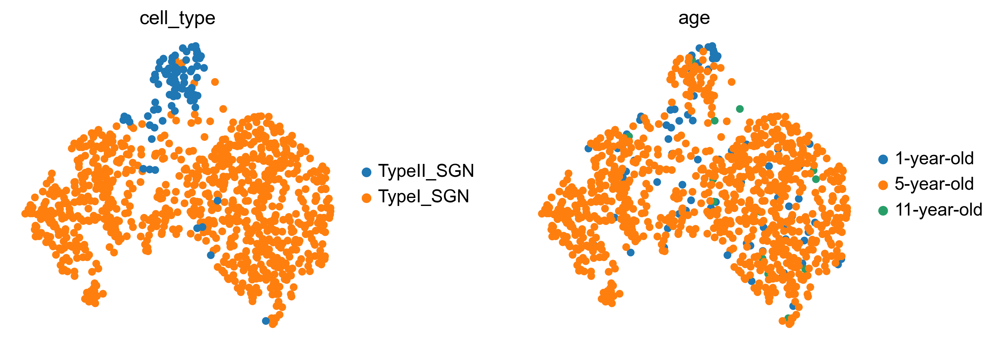

In [40]:
sc.pp.neighbors(adata_scvi_sgn, use_rep="X_scVI",n_neighbors=5)#,n_neighbors=90
sc.tl.umap(adata_scvi_sgn,min_dist=0.4)
adata_scvi_sgn
sc.pl.umap(adata_scvi_sgn, color=['cell_type','age'], wspace=0.4)

In [41]:
# Normally we would need to run scVI first but we have already done that here
# model_scvi = scvi.model.SCVI(adata_scvi) etc.
model_scanvi_sgn = scvi.model.SCANVI.from_scvi_model(
    vae_sgn, labels_key='cell_type', unlabeled_category="unlabelled"
)#unlabelled
print(model_scanvi_sgn)
model_scanvi_sgn.view_anndata_setup()

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\data\fields\_base_field.py:64: UserWarning: adata.layers[counts] does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


ScanVI Model with the following params: 
unlabeled_category: unlabelled, n_hidden: 128, n_latent: 30, n_layers: 2, dropout_rate: 0.1, dispersion: gene, 
gene_likelihood: zinb
Training status: Not Trained
Model's adata is minified?: False

Anndata setup with scvi-tools version 1.1.2.

Setup via `SCANVI.setup_anndata` with arguments:

{
│   'labels_key': 'cell_type',
│   'unlabeled_category': 'unlabelled',
│   'layer': 'counts',
│   'batch_key': 'age',
│   'size_factor_key': None,
│   'categorical_covariate_keys': None,
│   'continuous_covariate_keys': None
}

         Summary Statistics         
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┓
┃     Summary Stat Key     ┃ Value ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━┩
│         n_batch          │   3   │
│         n_cells          │  955  │
│ n_extra_categorical_covs │   0   │
│ n_extra_continuous_covs  │   0   │
│         n_labels         │   3   │
│          n_vars          │ 10000 │
└──────────────────────────┴───────┘

               Data Registry                
┏━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Registry Key ┃    scvi-tools Location    ┃
┡━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      X       │  adata.layers['counts']   │
│    batch     │ adata.obs['_scvi_batch']  │
│    labels    │ adata.obs['_scvi_labels'] │
└──────────────┴───────────────────────────┘

                  batch State Registry                  
┏━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃ Source Location  ┃ Categories  ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['age'] │ 1-year-old  │          0          │
│                  │ 5-year-old  │          1          │
│                  │ 11-year-old │          2          │
└──────────────────┴─────────────┴─────────────────────┘

                    labels State Registry                    
┏━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃    Source Location     ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['cell_type'] │ TypeII_SGN │          0          │
│                        │ TypeI_SGN  │          1          │
│                        │ unlabelled │          2          │
└────────────────────────┴────────────┴─────────────────────┘

In [42]:
max_epochs_scanvi_sgn = int(np.min([10, np.max([2, round(max_epochs_scvi_sgn / 3.0)])]))
model_scanvi_sgn.train(max_epochs=max_epochs_scanvi_sgn)

INFO     Training for 10 epochs.                                                                                   


GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
G:\Miniconda3\envs\scvi-env\lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=47` in the `DataLoader` to improve performance.
G:\Miniconda3\envs\scvi-env\lib\site-packages\lightning\pytorch\loops\fit_loop.py:293: The number of training batches (7) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Epoch 1/10:   0%|                                 | 0/10 [00:00<?, ?it/s]

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)


Epoch 2/10:  10%| | 1/10 [00:00<00:05,  1.72it/s, v_num=1, train_loss_ste

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)


Epoch 3/10:  20%|▏| 2/10 [00:01<00:04,  1.77it/s, v_num=1, train_loss_ste

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)


Epoch 4/10:  30%|▎| 3/10 [00:01<00:04,  1.74it/s, v_num=1, train_loss_ste

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)


Epoch 5/10:  40%|▍| 4/10 [00:02<00:03,  1.74it/s, v_num=1, train_loss_ste

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)


Epoch 6/10:  50%|▌| 5/10 [00:02<00:02,  1.74it/s, v_num=1, train_loss_ste

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)


Epoch 7/10:  60%|▌| 6/10 [00:03<00:02,  1.73it/s, v_num=1, train_loss_ste

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)


Epoch 8/10:  70%|▋| 7/10 [00:04<00:01,  1.71it/s, v_num=1, train_loss_ste

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)


Epoch 9/10:  80%|▊| 8/10 [00:04<00:01,  1.69it/s, v_num=1, train_loss_ste

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)


Epoch 10/10:  90%|▉| 9/10 [00:05<00:00,  1.69it/s, v_num=1, train_loss_st

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)


Epoch 10/10: 100%|█| 10/10 [00:05<00:00,  1.72it/s, v_num=1, train_loss_s

`Trainer.fit` stopped: `max_epochs=10` reached.


Epoch 10/10: 100%|█| 10/10 [00:05<00:00,  1.72it/s, v_num=1, train_loss_s


G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


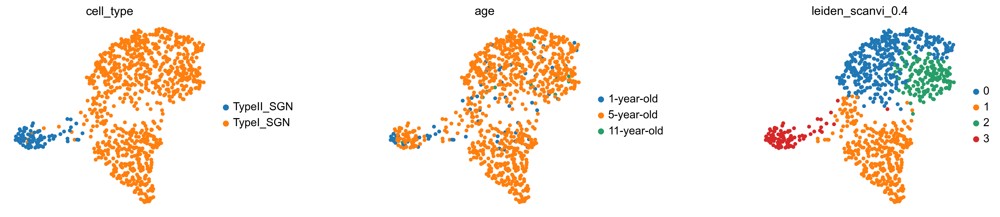

In [59]:
adata_scanvi_sgn = adata_scvi_sgn.copy()
adata_scanvi_sgn.obsm["X_scANVI"] = model_scanvi_sgn.get_latent_representation()
sc.pp.neighbors(adata_scanvi_sgn, use_rep="X_scANVI",n_neighbors=40)#n_neighbors=50
sc.tl.umap(adata_scanvi_sgn,min_dist=0.3)#0.4
sc.tl.leiden(adata_scanvi_sgn,resolution=0.5,key_added='leiden_scanvi_0.4')#0.4
sc.pl.umap(adata_scanvi_sgn, color=['cell_type','age','leiden_scanvi_0.4'], wspace=0.65,size=80)

In [63]:
pd.DataFrame(adata_scanvi_sgn.obsm["X_scANVI"]).to_csv('MACAQUE_SGN_scANVI.csv')

In [64]:
X_scANVI_sgn = pd.read_csv('MACAQUE_SGN_scANVI.csv', index_col=0)
X_scANVI_sgn

,0,1,2,3,4,5,6,7,8,9,...,20,21,22,23,24,25,26,27,28,29
0,-0.885486,0.850788,0.485874,-0.680408,-0.027371,-0.806968,-1.599416,0.955365,-0.037813,1.329960,...,-0.442834,0.028713,-0.502273,0.502034,0.021792,-2.068540,0.030366,0.175969,-0.401540,-1.363813
1,2.265612,0.447722,0.678350,1.049686,0.162754,-0.115128,-0.361070,1.266402,0.574940,-0.233098,...,-0.364951,-0.066366,0.928694,0.964349,0.149029,-2.155207,-1.704262,0.007802,2.351962,-2.998415
2,1.032471,0.209881,-0.251887,0.843251,0.068301,-0.185932,-1.576491,0.509749,-0.178595,2.084105,...,0.656184,-0.098441,-0.098575,0.012288,0.517942,-1.277260,-0.833424,0.046163,-0.326289,0.104246
3,2.567305,2.112946,-0.982820,-0.087883,0.188166,0.797200,-0.665617,-0.144716,1.494731,0.904597,...,0.865474,-0.016471,-0.335454,-1.548023,-0.641696,-1.298292,-1.799325,-0.169910,-0.682549,0.010179
4,0.372093,0.083830,-0.088421,-0.266318,-0.018206,-0.293797,-0.316324,-0.085804,-0.748677,0.718401,...,0.198704,0.048221,0.150601,-0.069303,0.736228,0.055091,0.187085,-0.043586,-0.510012,0.980912
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
950,0.185174,-2.192620,0.325218,0.393000,-0.880542,-1.461628,0.617682,0.385096,-0.876377,-0.428382,...,0.689912,-0.535784,-0.220022,-1.450333,-1.046719,-2.067571,-2.304345,0.270133,1.965042,-0.982870
951,0.931522,-0.972773,0.077119,-0.619055,-0.427612,-0.464107,1.407114,-0.891102,-0.820199,-0.256076,...,0.714891,-0.336294,-0.403451,-1.053510,0.382968,-0.201963,-0.799122,-0.097858,0.073768,0.410614
952,1.408863,-0.743927,-0.188872,-0.190110,-0.386417,-1.002744,0.102361,-0.105319,-0.630870,0.097450,...,0.843538,-0.344322,-0.401503,-0.484627,0.489436,0.056746,-1.622032,-0.131535,0.594892,0.641647
953,1.403077,-1.114355,-0.198409,-0.562326,-0.309877,-0.892949,0.674327,-1.140558,-0.544900,0.027212,...,0.874126,-0.402577,-0.978138,-0.799450,-0.043980,-0.342987,-1.280508,-0.088030,0.334034,0.156001


In [65]:
macaque_sgn.obsm["X_scANVI"] = X_scANVI_sgn.to_numpy()

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


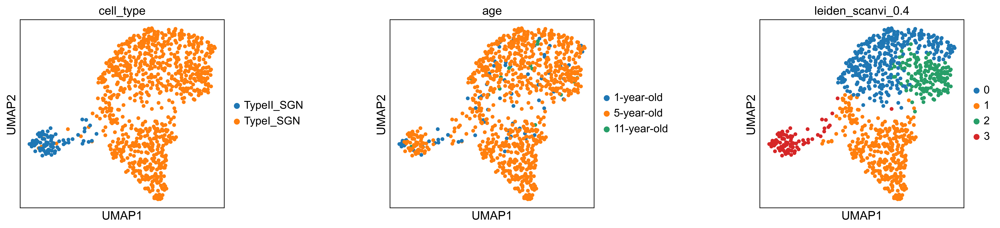

In [66]:
sc.pp.neighbors(macaque_sgn, use_rep="X_scANVI",n_neighbors=40)#n_neighbors=50
sc.tl.umap(macaque_sgn,min_dist=0.3)#0.4
sc.tl.leiden(macaque_sgn,resolution=0.5,key_added='leiden_scanvi_0.4')#0.4
sc.pl.umap(macaque_sgn, color=['cell_type','age','leiden_scanvi_0.4'], wspace=0.65,size=80)

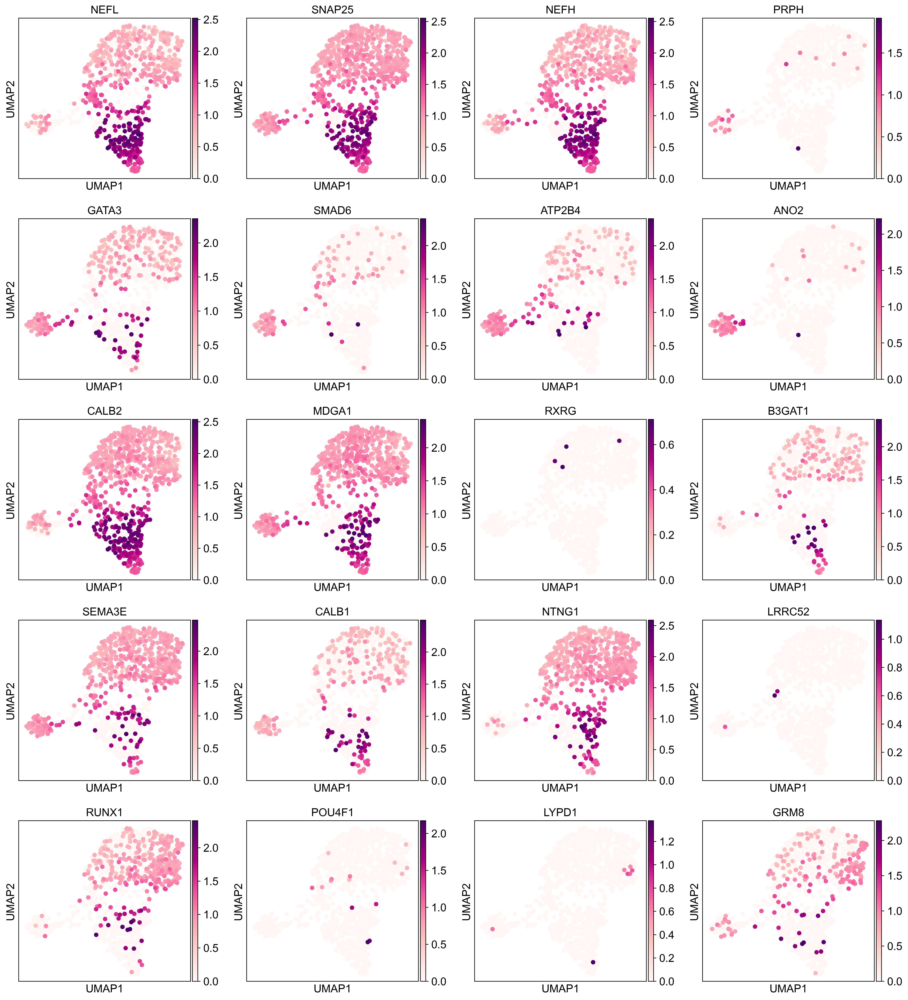

In [69]:
sc.settings.set_figure_params(dpi=200)
sc.pl.umap(macaque_sgn, color = ['NEFL','SNAP25','NEFH',
    'PRPH','GATA3','SMAD6','ATP2B4','ANO2',
                                      'CALB2','MDGA1',
                                 'RXRG','B3GAT1','SEMA3E','CALB1','NTNG1','LRRC52',
                                     'RUNX1','POU4F1','LYPD1','GRM8'], legend_loc = "on data", legend_fontsize = 5)

In [70]:
marker_genes = [
    'NEFL','SNAP25','NEFH',
    'PRPH','GATA3','SMAD6','ATP2B4','ANO2',
                                      'CALB2','MDGA1',
                                 'RXRG','B3GAT1','SEMA3E','CALB1','NTNG1','LRRC52',
                                     'RUNX1','POU4F1','LYPD1','GRM8'   
]

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


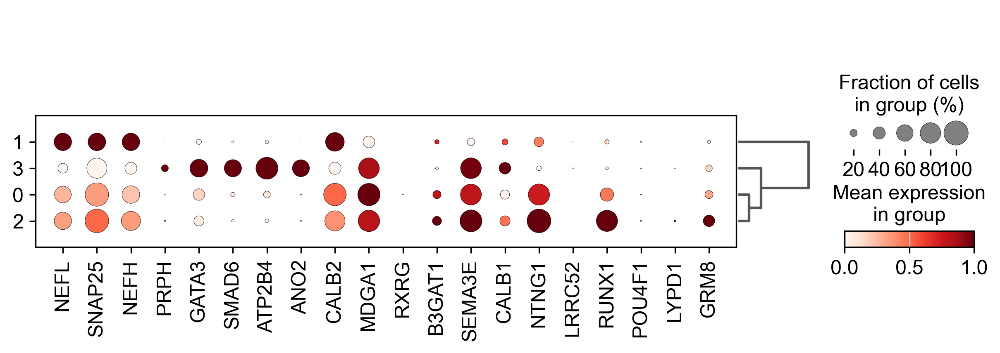

In [72]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(macaque_sgn, groupby="leiden_scanvi_0.4")
sc.pl.dotplot(macaque_sgn, marker_genes, groupby="leiden_scanvi_0.4",standard_scale="var",
             dendrogram=True)

In [86]:
macaque_sgn

AnnData object with n_obs × n_vars = 955 × 15315
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb', 'louvain', 'cluster', 'cluster2', 'cell_type2', 'cell_type3', 'batch', 'age', 'cluster3', 'cell_type', 'n_counts', 'leiden_res2', 'leiden_res5', 'cluster4', 'region', '_scvi_batch', '_scvi_labels', 'leiden_scanvi_0.4'
    var: 'gene_ids', 'feature_types', 'Gene', 'highly_variable-2', 'mt-2', 'n_cells_by_counts-2', 'mean_counts-2', 'pct_dropout_by_counts-2', 'total_counts-2', 'means-2', 'dispersions-2', 'dispersions_norm-2', 'highly_variable-3', 'mt-3', 'n_cells_by_counts-3', 'mean_counts-3', 'pct_dropout_by_counts-3', 'total_counts-3', 'means-3', 'dispersions-3', 'dispersions_norm-3', 'highly_variable-4', 'mt-4', 'n_cells_by_counts-4', 'mean_counts-4', 'pct_dropout_by_counts-4', 'total_counts-4',

In [134]:
cluster_annotation = {
    '0': 'TypeIB_macaque',
    '1': 'TypeIA_macaque',
    '2': 'TypeIC_macaque',
    '3': 'TypeII_macaque',
   
}
macaque_sgn.obs['celltype_species'] = macaque_sgn.obs['leiden_scanvi_0.4'].map(cluster_annotation).astype('category')

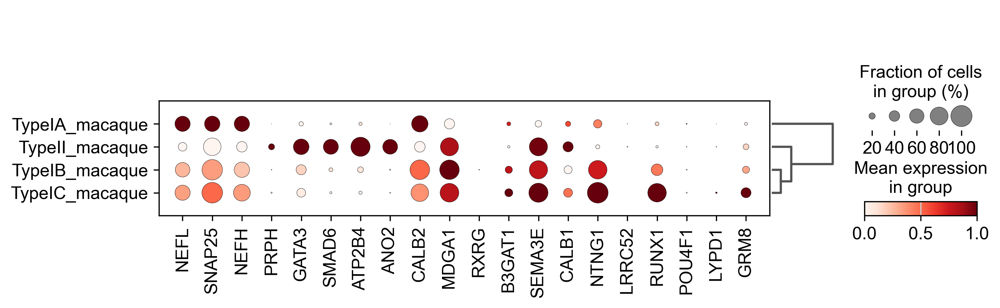

In [135]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(macaque_sgn, groupby="celltype_species")
sc.pl.dotplot(macaque_sgn, marker_genes, groupby="celltype_species",standard_scale="var",
             dendrogram=True)

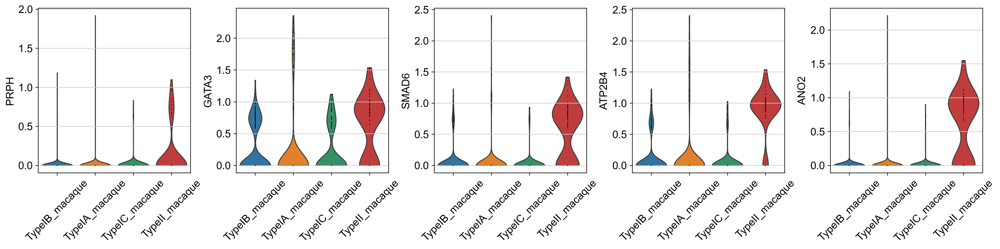

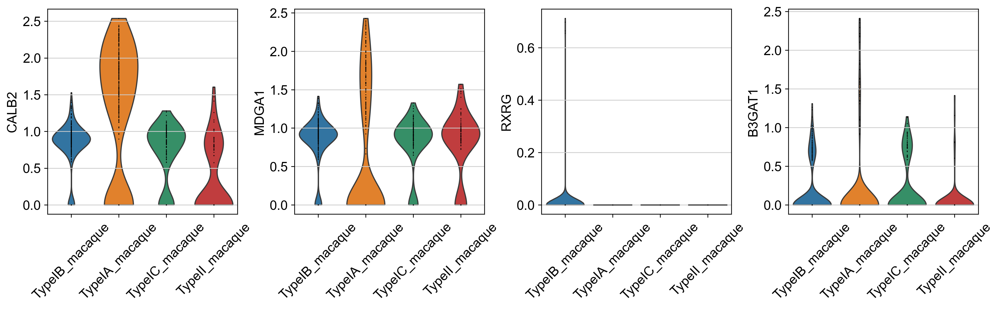

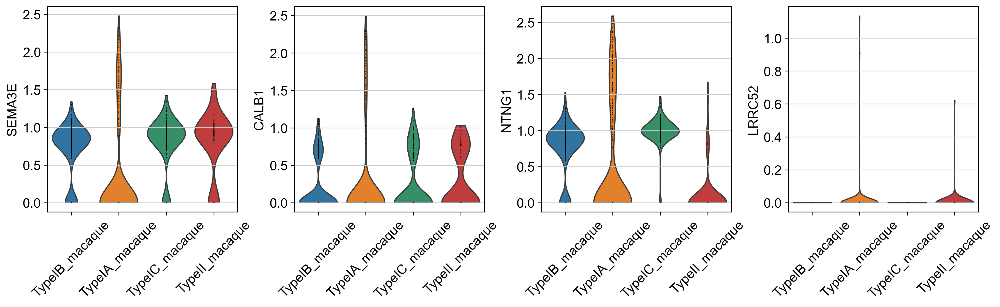

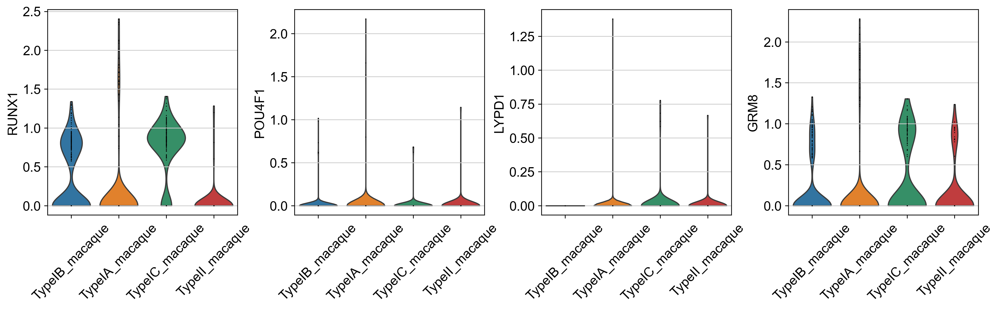

In [138]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(macaque_sgn, groupby="celltype_species")
#sc.pl.violin(macaque_sgn, ['NEFL','SNAP25','NEFH','MAP2'], groupby="celltype_species",jitter=False,rotation=45,)
sc.pl.violin(macaque_sgn, ['PRPH','GATA3','SMAD6','ATP2B4','ANO2'], groupby="celltype_species",jitter=False,rotation=45,)
sc.pl.violin(macaque_sgn, ['CALB2','MDGA1', 'RXRG','B3GAT1'], groupby="celltype_species",jitter=False,rotation=45,)
sc.pl.violin(macaque_sgn, ['SEMA3E','CALB1','NTNG1','LRRC52'], groupby="celltype_species",jitter=False,rotation=45,)
sc.pl.violin(macaque_sgn, ['RUNX1','POU4F1','LYPD1','GRM8'], groupby="celltype_species",jitter=False,rotation=45,)

In [139]:
macaque_sgn.write('MACAQUE_SGN_scanvi_scvi.h5ad')

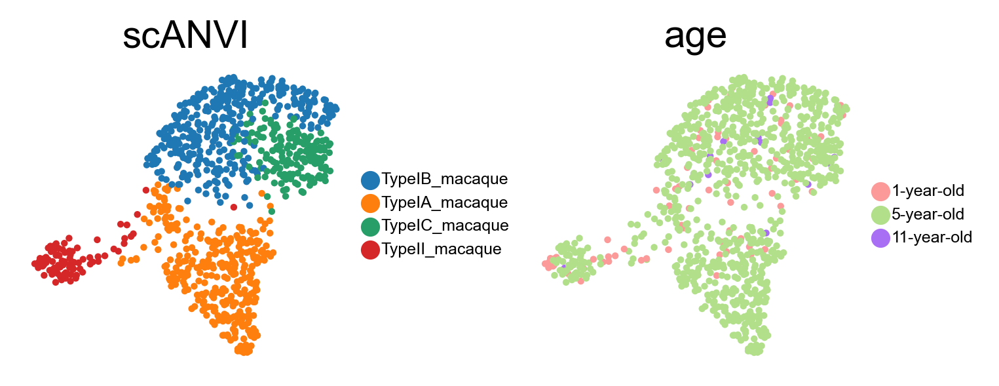

In [140]:
sc.set_figure_params(figsize=(2,2),frameon=False,dpi=150,dpi_save=600)
sc.pl.umap(macaque_sgn, color=['celltype_species','age'], wspace=0.4,
           size=25,
           legend_fontsize=6,ncols = 3,title='scANVI',
           save='_MACAQUE_SGN_SCANVI.pdf'
          )

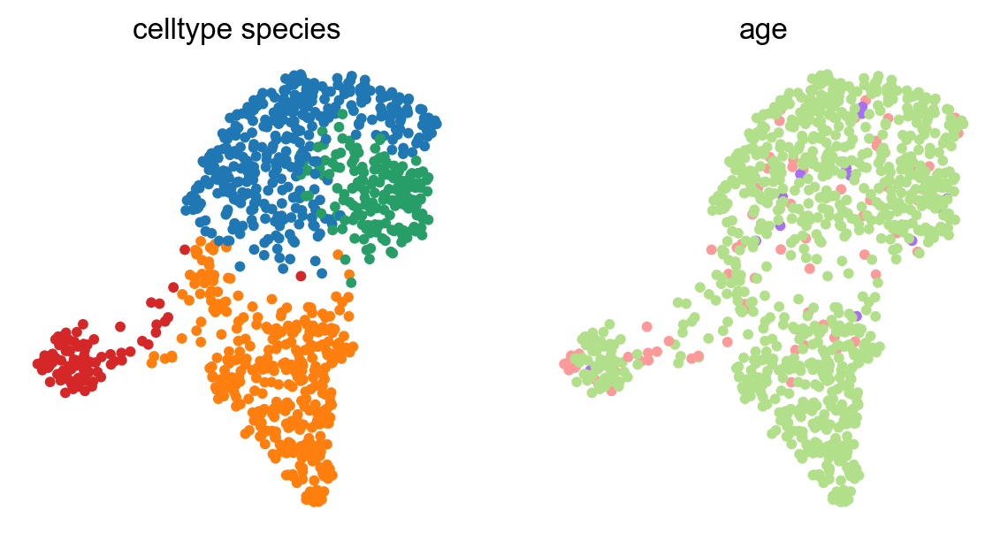

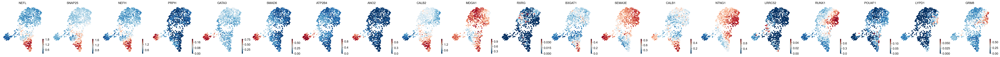

In [141]:
import scvelo as scv
scv.set_figure_params(figsize=(3.5,3.5))
scv.pl.umap(macaque_sgn,color=["celltype_species","age"])

scv.pl.umap(macaque_sgn, color=['NEFL','SNAP25','NEFH',
    'PRPH','GATA3','SMAD6','ATP2B4','ANO2',
                                      'CALB2','MDGA1',
                                 'RXRG','B3GAT1','SEMA3E','CALB1','NTNG1','LRRC52',
                                     'RUNX1','POU4F1','LYPD1','GRM8'],smooth=True)

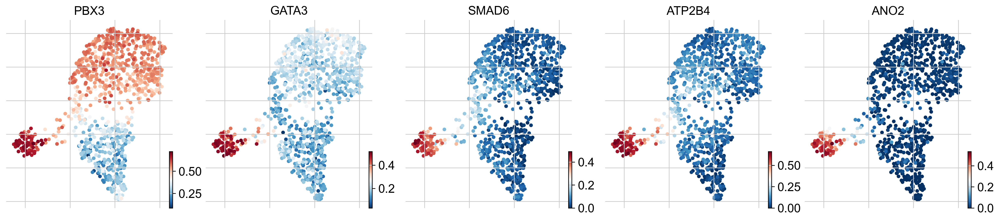

In [228]:
scv.pl.umap(macaque_sgn, color=['PBX3','GATA3','SMAD6','ATP2B4','ANO2',
   ],smooth=True)

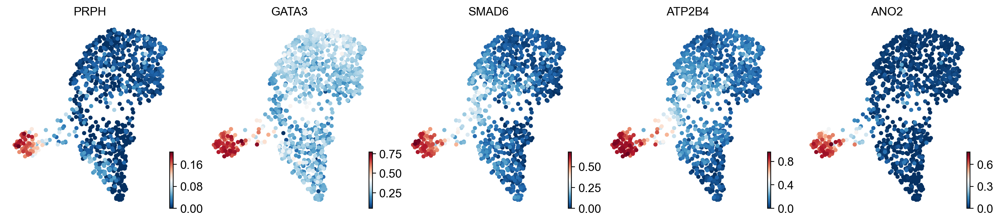

In [142]:
scv.pl.umap(macaque_sgn, color=['PRPH','GATA3','SMAD6','ATP2B4','ANO2',
   ],smooth=True)

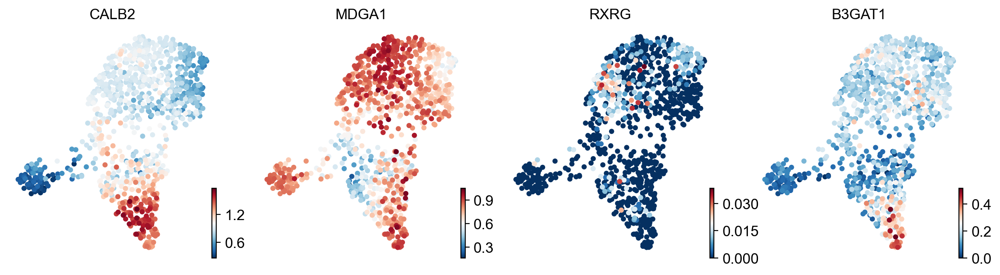

In [143]:
scv.pl.umap(macaque_sgn, color=['CALB2','MDGA1',
                                 'RXRG','B3GAT1',
   ],smooth=True)

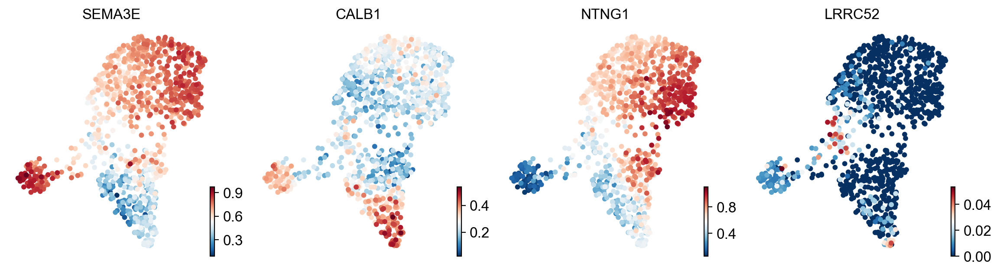

In [144]:
scv.pl.umap(macaque_sgn, color=['SEMA3E','CALB1','NTNG1','LRRC52',
   ],smooth=True)

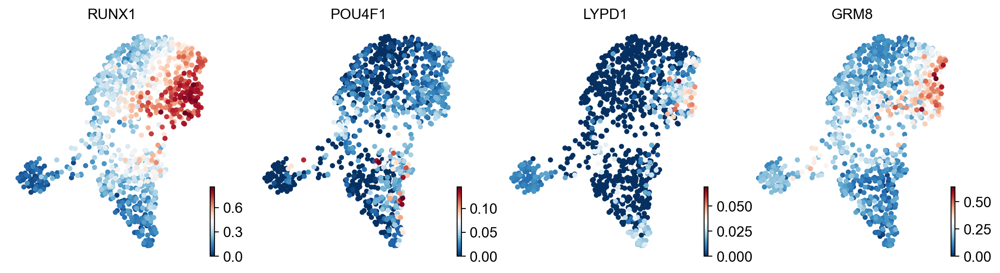

In [145]:
scv.pl.umap(macaque_sgn, color=['RUNX1','POU4F1','LYPD1','GRM8'
   ],smooth=True)

In [146]:
scv.set_figure_params(figsize=(4,4))
import matplotlib.pyplot as plt

In [147]:
type2=['GATA3','SMAD6','ATP2B4','ANO2',]
type1=['NEFL','SNAP25','NEFH','MAP2']
type1bc=[ 'SEMA3E','CALB1','NTNG1','LRRC52','RUNX1','POU4F1','LYPD1','GRM8']
type1a=['CALB2','MDGA1','RXRG','B3GAT1',]                               

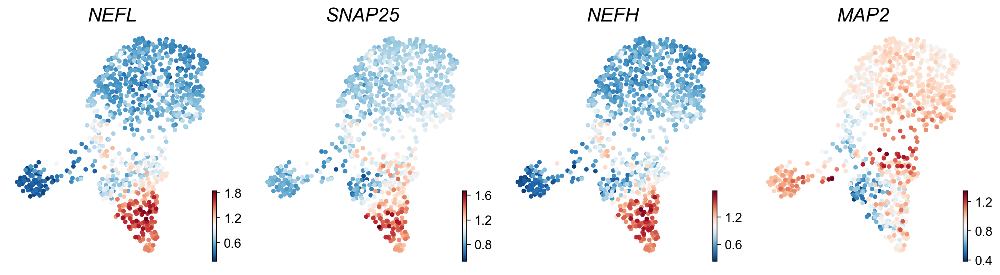

In [148]:
axs=scv.pl.umap(macaque_sgn,color=type1,smooth=True,show=False)
for ax in axs:
    ax.set_title(ax.get_title(),style="italic",fontsize=18)
plt.savefig("figures/TYPE1_MACAQUE_v2.pdf",dpi=600)

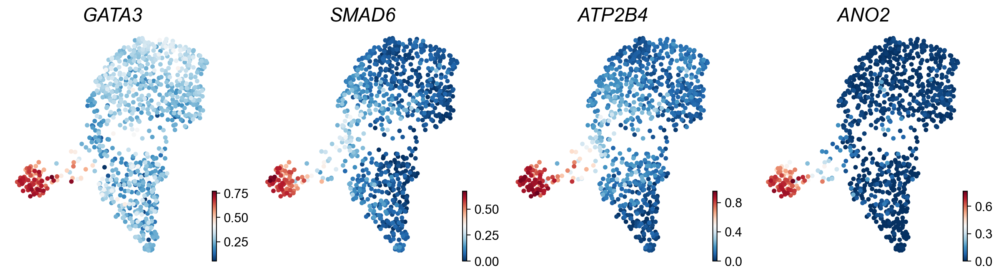

In [149]:
axs=scv.pl.umap(macaque_sgn,color=type2,smooth=True,show=False)
for ax in axs:
    ax.set_title(ax.get_title(),style="italic",fontsize=18)
plt.savefig("figures/TYPE2_MACAQUE_v2.pdf",dpi=600)

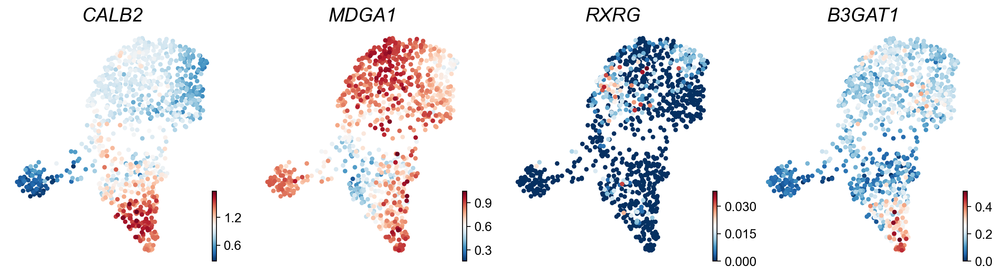

In [150]:
axs=scv.pl.umap(macaque_sgn,color=type1a,smooth=True,show=False)
for ax in axs:
    ax.set_title(ax.get_title(),style="italic",fontsize=18)
plt.savefig("figures/TYPE1a_MACAQUE_v2.pdf",dpi=600)

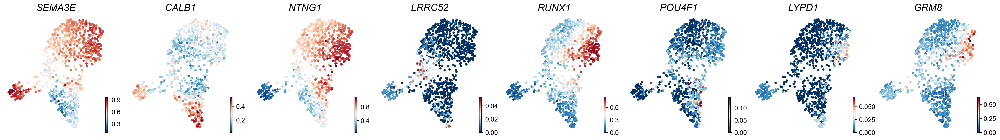

In [151]:
axs=scv.pl.umap(macaque_sgn,color=type1bc,smooth=True,show=False)
for ax in axs:
    ax.set_title(ax.get_title(),style="italic",fontsize=18)
plt.savefig("figures/TYPE1bc_MACAQUE_v2.pdf",dpi=600)

saving figure to file ./figures/scvelo_macaque_sgn_age_v2.pdf


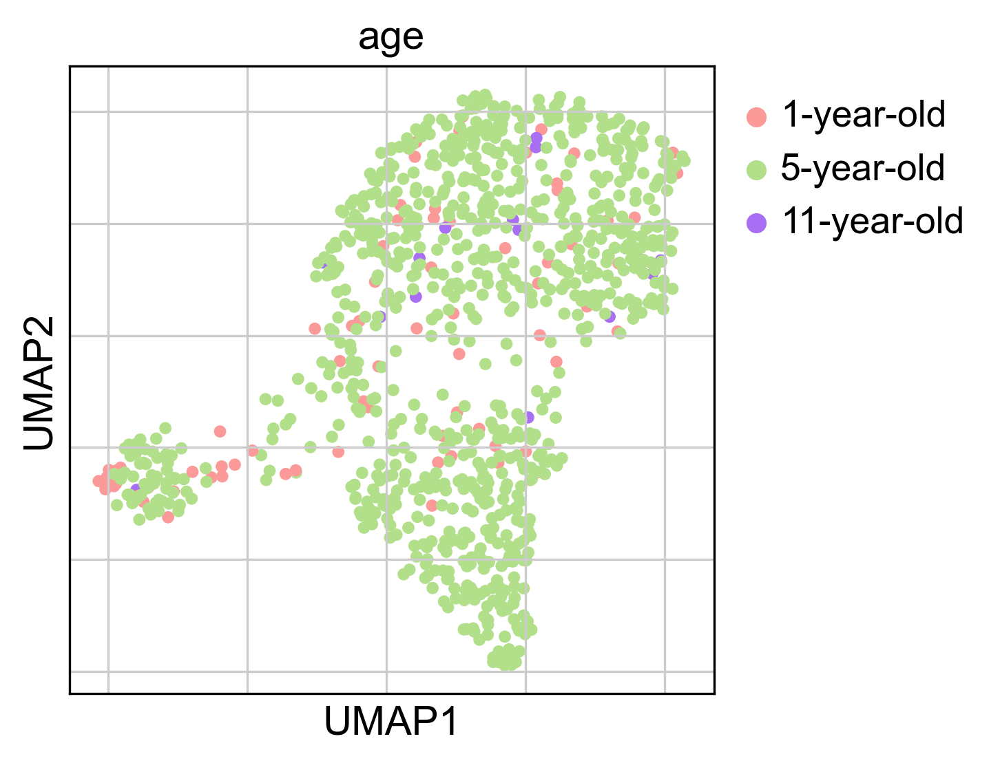

In [152]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
scv.pl.umap(macaque_sgn,color="age",palette=["#FB9A99","#B2DF8A","#a86ef4"]
           ,frameon=True, save="macaque_sgn_age_v2.pdf")

In [153]:
sgn_combined=macaque_sgn.concatenate(mouse_sgn)

In [154]:
sgn_combined

AnnData object with n_obs × n_vars = 1747 × 12951
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb', 'louvain', 'cluster', 'cluster2', 'cell_type2', 'cell_type3', 'batch', 'age', 'cluster3', 'cell_type', 'n_counts', 'leiden_res2', 'leiden_res5', 'cluster4', 'region', '_scvi_batch', '_scvi_labels', 'leiden_scanvi_0.4', 'celltype_species', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'integrated_snn_res.0.8', 'seurat_clusters', 'integrated_snn_res.1', 'integrated_snn_res.0.1', 'integrated_snn_res.0.2', 'integrated_snn_res.0.3', 'integrated_snn_res.0.4', 'integrated_snn_res.0.5', 'integrated_snn_res.0.6', 'integrated_snn_res.0.7', 'integrated_snn_res.0.9', 'subclass_label', 'cluster_label', 'seurat_clusters.new'
    var: 'gene_ids-0', 'feature_types-0', '

In [155]:
sc.pp.normalize_total(sgn_combined)
sc.pp.log1p(sgn_combined)

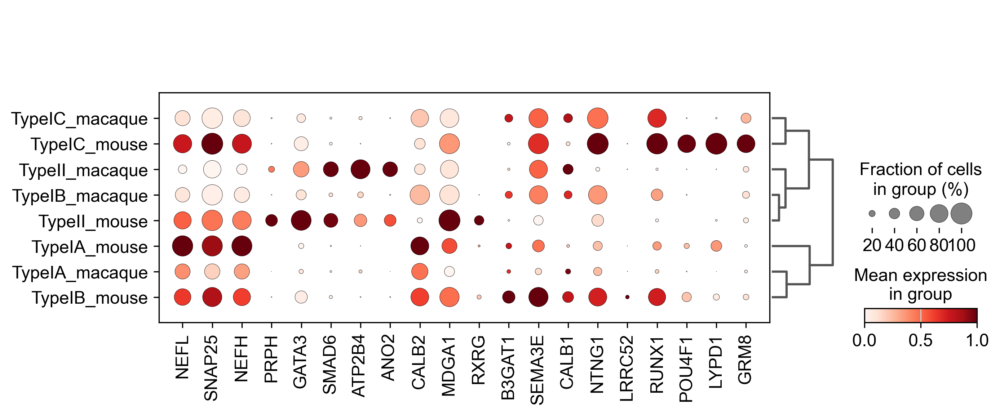

In [156]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(sgn_combined, groupby="celltype_species")
sc.pl.dotplot(sgn_combined, marker_genes, groupby="celltype_species",standard_scale="var",
             dendrogram=True)

In [169]:
small_marker_dict={'Type I':["SYT2","EPHA4","TSC22D3","KCNA1","RYR2"],
                  'Type II':["GATA3","SMAD6","ATP2B4", "ANO2","TH","PRPH"], 
'Type IA':["CALB2","MDGA1","B3GAT1","RXRG"],
'Type IB':["SEMA3E","NTNG1", "CALB1","LRRC52"],
  'Type IC':["RUNX1","GRM8","POU4F1","LYPD1" ],   
    
}

# check if the markers are in the data
smarker_genes_in_data = dict()
for ct, markers in small_marker_dict.items():
    markers_found = list()
    for marker in markers:
        if marker in sgn_combined.var.index:
            markers_found.append(marker)
    smarker_genes_in_data[ct] = markers_found
#del [] # remove the last marker
del_markers = list()
for ct, markers in smarker_genes_in_data.items():
    if markers==[]:
        del_markers.append(ct)
for ct in del_markers:
    del smarker_genes_in_data[ct]

In [170]:
smarker_genes_in_data

{'Type I': ['SYT2', 'EPHA4', 'TSC22D3', 'KCNA1', 'RYR2'],
 'Type II': ['GATA3', 'SMAD6', 'ATP2B4', 'ANO2', 'TH', 'PRPH'],
 'Type IA': ['CALB2', 'MDGA1', 'B3GAT1', 'RXRG'],
 'Type IB': ['SEMA3E', 'NTNG1', 'CALB1', 'LRRC52'],
 'Type IC': ['RUNX1', 'GRM8', 'POU4F1', 'LYPD1']}

In [171]:
sgn_combined.obs['celltype_species'].cat.reorder_categories(['TypeII_macaque', 'TypeII_mouse',
                                                         'TypeIA_macaque','TypeIA_mouse', 
                                                            'TypeIB_macaque', 'TypeIB_mouse','TypeIC_macaque','TypeIC_mouse',
                                                          
                                                           
                                                         ], inplace=True)

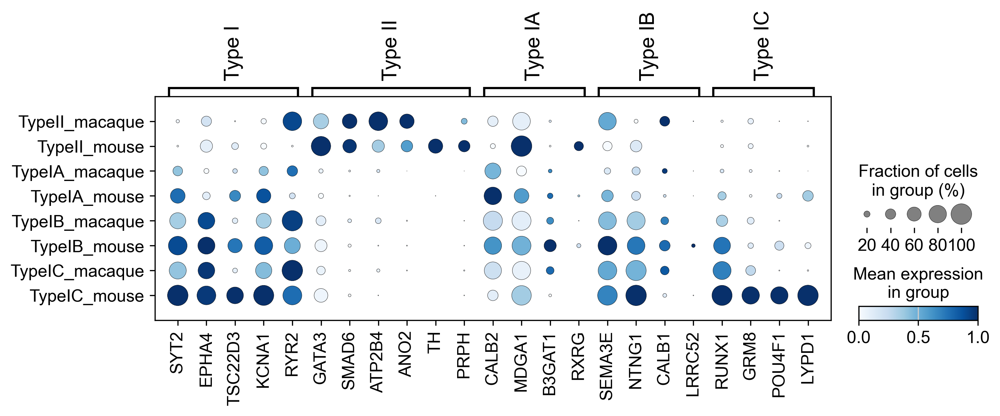

In [172]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.dotplot(
    sgn_combined,
    groupby="celltype_species",
    var_names=smarker_genes_in_data,
   #dendrogram=True,
    cmap='Blues',
    standard_scale="var",  # standard scale: normalize each gene to range from 0 to 1
     save="_SGN_macaque_mouse_selective_markers.pdf"
)

In [161]:
macaque_sgn.write('MACAQUE_SGN_scanvi_scvi.h5ad')

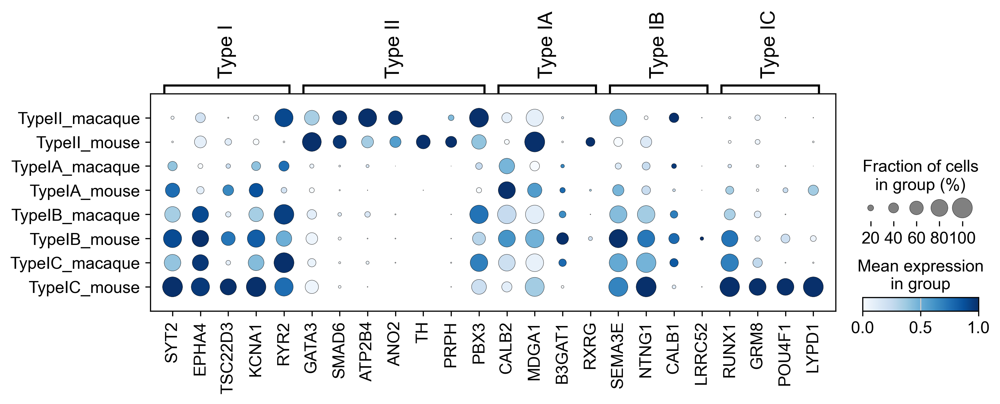

In [168]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.dotplot(
    sgn_combined,
    groupby="celltype_species",
    var_names=smarker_genes_in_data,
   #dendrogram=True,
    cmap='Blues',
    standard_scale="var",  # standard scale: normalize each gene to range from 0 to 1
    # save="_SGN_macaque_mouse_selective_markers.pdf"
)

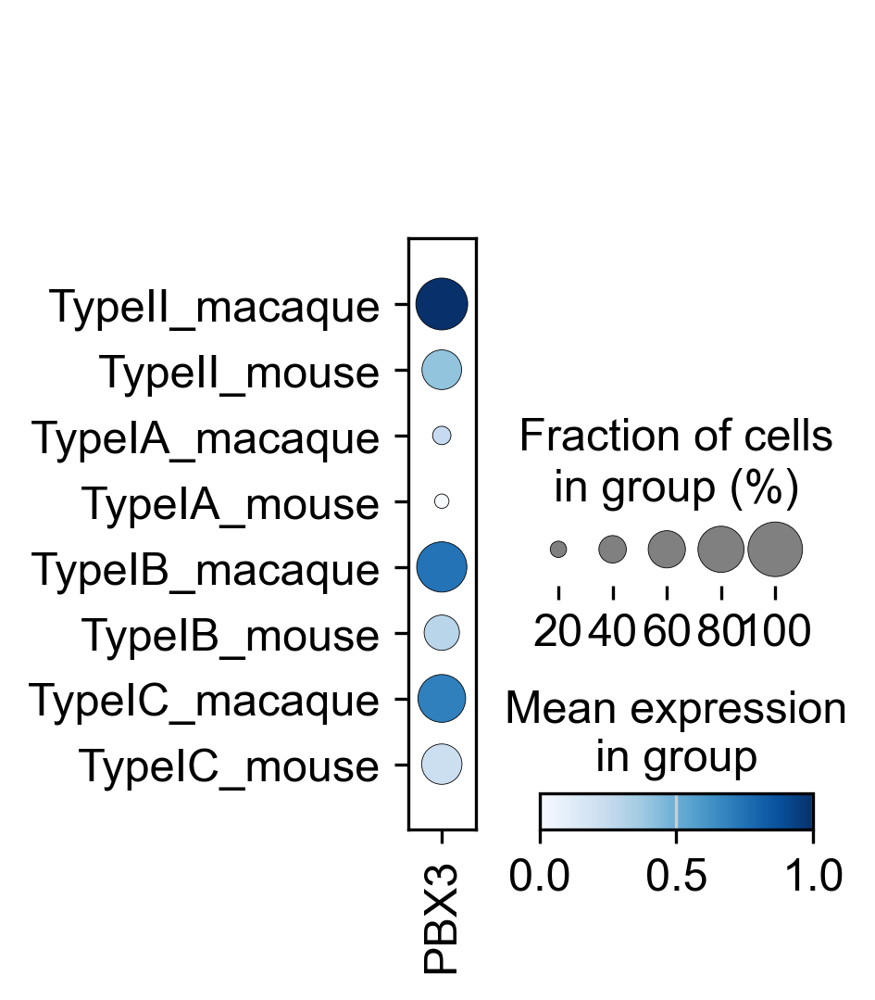

In [214]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.dotplot(
    sgn_combined,
    groupby="celltype_species",
    var_names=['PBX3'],
   #dendrogram=True,
    cmap='Blues',
    standard_scale="var",  # standard scale: normalize each gene to range from 0 to 1
    save="_SGN_macaque_mouse_PBX3.pdf"
)

In [220]:
macaque_sgn.obs['celltype_species'].cat.reorder_categories(['TypeII_macaque', 
                                                         'TypeIA_macaque',
                                                            'TypeIB_macaque', 'TypeIC_macaque'
                                                          
                                                           
                                                         ], inplace=True)

In [222]:
mouse_sgn.obs['celltype_species'].cat.reorder_categories(['TypeII_mouse', 
                                                         'TypeIA_mouse',
                                                            'TypeIB_mouse', 'TypeIC_mouse'
                                                          
                                                           
                                                         ], inplace=True)

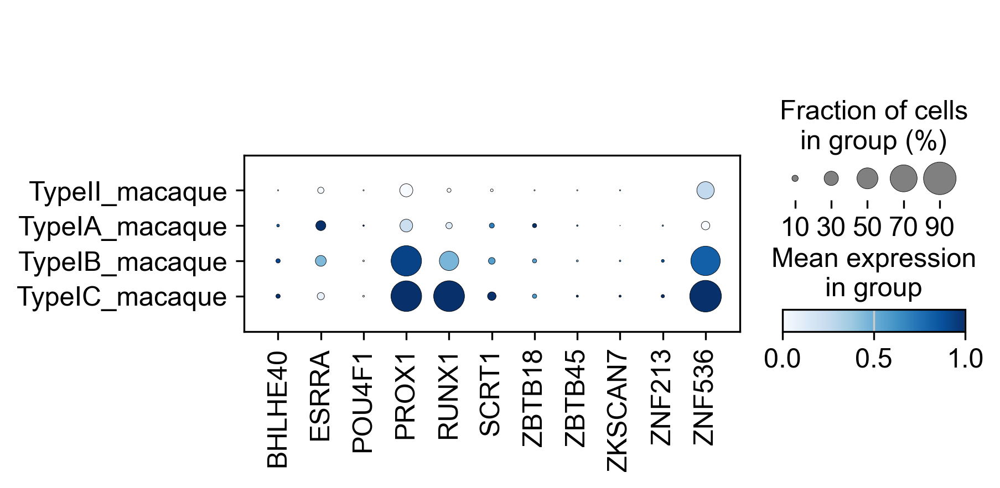

In [224]:
#plot type1 conserved tf
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.dotplot(
    macaque_sgn,
    groupby="celltype_species",
    var_names=['BHLHE40','ESRRA','POU4F1','PROX1','RUNX1','SCRT1','ZBTB18','ZBTB45','ZKSCAN7','ZNF213','ZNF536'],
   #dendrogram=True,
    cmap='Blues',
    standard_scale="var",  # standard scale: normalize each gene to range from 0 to 1
    save="_SGN_macaque_type1_conserved_tf.pdf"
)

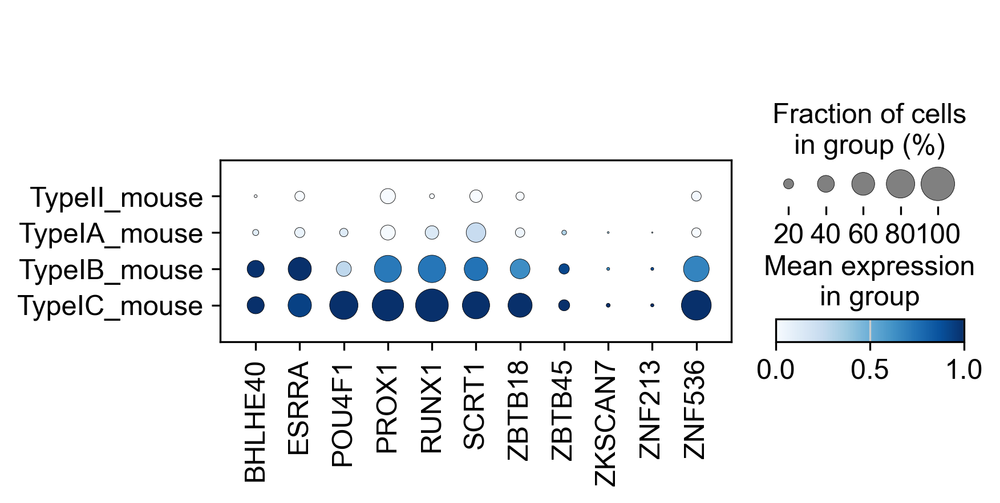

In [225]:
#plot type1 conserved tf
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.dotplot(
    mouse_sgn,
    groupby="celltype_species",
    var_names=['BHLHE40','ESRRA','POU4F1','PROX1','RUNX1','SCRT1','ZBTB18','ZBTB45','ZKSCAN7','ZNF213','ZNF536'],
   #dendrogram=True,
    cmap='Blues',
    standard_scale="var",  # standard scale: normalize each gene to range from 0 to 1
    save="_SGN_mouse_type1_conserved_tf.pdf"
)

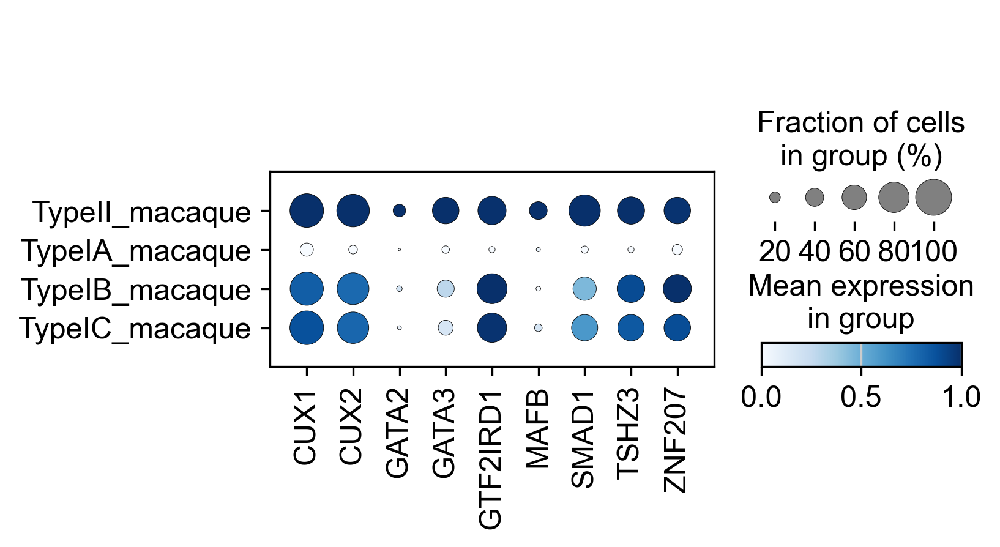

In [226]:
#plot type2 conserved tf
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.dotplot(
    macaque_sgn,
    groupby="celltype_species",
    var_names=['CUX1','CUX2','GATA2','GATA3','GTF2IRD1','MAFB','SMAD1','TSHZ3','ZNF207'],
   #dendrogram=True,
    cmap='Blues',
    standard_scale="var",  # standard scale: normalize each gene to range from 0 to 1
    save="_SGN_macaque_type2_conserved_tf.pdf"
)

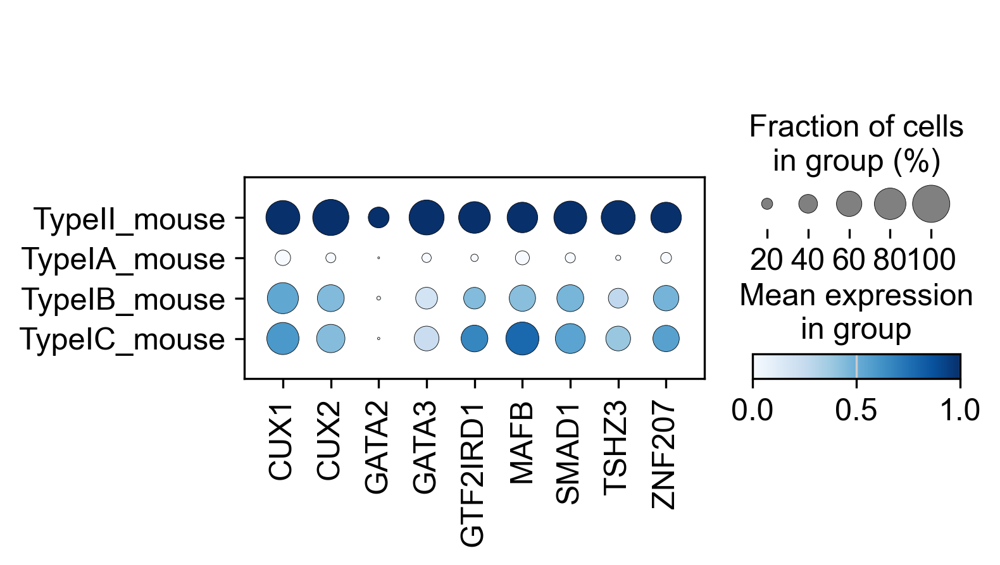

In [227]:
#plot type2 conserved tf
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.dotplot(
    mouse_sgn,
    groupby="celltype_species",
    var_names=['CUX1','CUX2','GATA2','GATA3','GTF2IRD1','MAFB','SMAD1','TSHZ3','ZNF207'],
   #dendrogram=True,
    cmap='Blues',
    standard_scale="var",  # standard scale: normalize each gene to range from 0 to 1
    save="_SGN_mouse_type2_conserved_tf.pdf"
)

In [233]:
mouse_sgn

AnnData object with n_obs × n_vars = 792 × 14530
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'integrated_snn_res.0.8', 'seurat_clusters', 'integrated_snn_res.1', 'integrated_snn_res.0.1', 'integrated_snn_res.0.2', 'integrated_snn_res.0.3', 'integrated_snn_res.0.4', 'integrated_snn_res.0.5', 'integrated_snn_res.0.6', 'integrated_snn_res.0.7', 'integrated_snn_res.0.9', 'subclass_label', 'cluster_label', 'seurat_clusters.new', 'celltype_species'
    var: 'name'
    uns: 'celltype_species_colors', 'log1p', 'rank_genes_groups'
    obsm: 'X_pca', 'X_umap'

In [173]:
macaque_sgn

AnnData object with n_obs × n_vars = 955 × 15315
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb', 'louvain', 'cluster', 'cluster2', 'cell_type2', 'cell_type3', 'batch', 'age', 'cluster3', 'cell_type', 'n_counts', 'leiden_res2', 'leiden_res5', 'cluster4', 'region', '_scvi_batch', '_scvi_labels', 'leiden_scanvi_0.4', 'celltype_species'
    var: 'gene_ids', 'feature_types', 'Gene', 'highly_variable-2', 'mt-2', 'n_cells_by_counts-2', 'mean_counts-2', 'pct_dropout_by_counts-2', 'total_counts-2', 'means-2', 'dispersions-2', 'dispersions_norm-2', 'highly_variable-3', 'mt-3', 'n_cells_by_counts-3', 'mean_counts-3', 'pct_dropout_by_counts-3', 'total_counts-3', 'means-3', 'dispersions-3', 'dispersions_norm-3', 'highly_variable-4', 'mt-4', 'n_cells_by_counts-4', 'mean_counts-4', 'pct_dropout_by_counts-4

In [176]:
# convert object to seurat 
macaque_sgn.write_loom('macaque_sgn2.loom',write_obsm_varm=True)
macaque_sgn.obs.to_csv('macaque_sgn_obs2.csv')
macaque_sgn.var.to_csv('macaque_sgn_var2.csv')

In [177]:
import collections

In [198]:
collections.Counter(macaque_sgn.obs['cell_type'])

Counter({'TypeI_SGN': 871, 'TypeII_SGN': 84})

In [200]:
collections.Counter(mouse_sgn.obs['subclass_label'])

Counter({'Type I': 766, 'Type II': 26})

In [179]:
sc.pp.log1p(macaque_sgn)

In [188]:
sc.pp.log1p(mouse_sgn)

In [180]:
sc.tl.rank_genes_groups(macaque_sgn, 'cell_type',method='t-test',corr_method='benjamini-hochberg')

In [202]:
sc.tl.rank_genes_groups(mouse_sgn, 'subclass_label',method='t-test',corr_method='benjamini-hochberg')

In [181]:
pd.DataFrame(macaque_sgn.uns['rank_genes_groups']['names'])

,TypeII_SGN,TypeI_SGN
0,TNR,PRMT8
1,LRRTM4,DLGAP2
2,LRRTM3,THY1
3,ATP2B4,SYT2
4,CNTN3,NTNG1
...,...,...
15310,NTNG1,CNTN3
15311,SYT2,ATP2B4
15312,THY1,LRRTM3
15313,DLGAP2,LRRTM4


In [205]:
pd.DataFrame(mouse_sgn.uns['rank_genes_groups']['names'])

,Type I,Type II
0,SYT2,AGPAT3
1,TM6SF1,TMEM132E
2,SV2B,RPH3A
3,THY1,PRUNE2
4,CPNE9,GLDN
...,...,...
14525,GLDN,CPNE9
14526,PRUNE2,THY1
14527,RPH3A,SV2B
14528,TMEM132E,TM6SF1


In [182]:
adata_macaque=macaque_sgn.copy()
adata_macaque

AnnData object with n_obs × n_vars = 955 × 15315
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb', 'louvain', 'cluster', 'cluster2', 'cell_type2', 'cell_type3', 'batch', 'age', 'cluster3', 'cell_type', 'n_counts', 'leiden_res2', 'leiden_res5', 'cluster4', 'region', '_scvi_batch', '_scvi_labels', 'leiden_scanvi_0.4', 'celltype_species'
    var: 'gene_ids', 'feature_types', 'Gene', 'highly_variable-2', 'mt-2', 'n_cells_by_counts-2', 'mean_counts-2', 'pct_dropout_by_counts-2', 'total_counts-2', 'means-2', 'dispersions-2', 'dispersions_norm-2', 'highly_variable-3', 'mt-3', 'n_cells_by_counts-3', 'mean_counts-3', 'pct_dropout_by_counts-3', 'total_counts-3', 'means-3', 'dispersions-3', 'dispersions_norm-3', 'highly_variable-4', 'mt-4', 'n_cells_by_counts-4', 'mean_counts-4', 'pct_dropout_by_counts-4

In [186]:
# keep marker gene list
with pd.ExcelWriter('macaque_sgn_subclass_marker.xlsx') as writer:
    for cell_type_name in list(collections.Counter(adata_macaque.obs['cell_type'])):
        celltype_list = []
        gene_list = list(pd.DataFrame(adata_macaque.uns['rank_genes_groups']['names'])[cell_type_name][np.array(pd.DataFrame(adata_macaque.uns['rank_genes_groups']['pvals_adj'])[cell_type_name]<0.05)*np.array(pd.DataFrame(adata_macaque.uns['rank_genes_groups']['logfoldchanges'])[cell_type_name]>0)])
        score_list = list(pd.DataFrame(adata_macaque.uns['rank_genes_groups']['scores'])[cell_type_name][np.array(pd.DataFrame(adata_macaque.uns['rank_genes_groups']['pvals_adj'])[cell_type_name]<0.05)*np.array(pd.DataFrame(adata_macaque.uns['rank_genes_groups']['logfoldchanges'])[cell_type_name]>0)])
        logfc_list = list(pd.DataFrame(adata_macaque.uns['rank_genes_groups']['logfoldchanges'])[cell_type_name][np.array(pd.DataFrame(adata_macaque.uns['rank_genes_groups']['pvals_adj'])[cell_type_name]<0.05)*np.array(pd.DataFrame(adata_macaque.uns['rank_genes_groups']['logfoldchanges'])[cell_type_name]>0)])
        pvals_list = list(pd.DataFrame(adata_macaque.uns['rank_genes_groups']['pvals'])[cell_type_name][np.array(pd.DataFrame(adata_macaque.uns['rank_genes_groups']['pvals_adj'])[cell_type_name]<0.05)*np.array(pd.DataFrame(adata_macaque.uns['rank_genes_groups']['logfoldchanges'])[cell_type_name]>0)])
        padj_list = list(pd.DataFrame(adata_macaque.uns['rank_genes_groups']['pvals_adj'])[cell_type_name][np.array(pd.DataFrame(adata_macaque.uns['rank_genes_groups']['pvals_adj'])[cell_type_name]<0.05)*np.array(pd.DataFrame(adata_macaque.uns['rank_genes_groups']['logfoldchanges'])[cell_type_name]>0)])
        celltype_list = [cell_type_name]*len(gene_list)
        #result_df = pd.DataFrame({'Celltype':celltype_list,'Gene':gene_list,'Scores':score_list,'Logfoldchanges':logfc_list,'Pvals':pvals_list,'Pvals_adj':padj_list})
        result_df = pd.DataFrame({'Gene':gene_list,'Pvals':pvals_list,'Pvals_adj':padj_list,'Logfoldchanges':logfc_list})
        filename = cell_type_name
        result_df.to_excel(writer,sheet_name=filename,index=False)

In [210]:
# keep marker gene list
with pd.ExcelWriter('mouse_sgn_subclass_marker.xlsx') as writer:
    for cell_type_name in list(collections.Counter(mouse_sgn.obs['subclass_label'])):
        celltype_list = []
        gene_list = list(pd.DataFrame(mouse_sgn.uns['rank_genes_groups']['names'])[cell_type_name][np.array(pd.DataFrame(mouse_sgn.uns['rank_genes_groups']['pvals_adj'])[cell_type_name]<0.05)*np.array(pd.DataFrame(mouse_sgn.uns['rank_genes_groups']['logfoldchanges'])[cell_type_name]>0)])
        score_list = list(pd.DataFrame(mouse_sgn.uns['rank_genes_groups']['scores'])[cell_type_name][np.array(pd.DataFrame(mouse_sgn.uns['rank_genes_groups']['pvals_adj'])[cell_type_name]<0.05)*np.array(pd.DataFrame(mouse_sgn.uns['rank_genes_groups']['logfoldchanges'])[cell_type_name]>0)])
        logfc_list = list(pd.DataFrame(mouse_sgn.uns['rank_genes_groups']['logfoldchanges'])[cell_type_name][np.array(pd.DataFrame(mouse_sgn.uns['rank_genes_groups']['pvals_adj'])[cell_type_name]<0.05)*np.array(pd.DataFrame(mouse_sgn.uns['rank_genes_groups']['logfoldchanges'])[cell_type_name]>0)])
        pvals_list = list(pd.DataFrame(mouse_sgn.uns['rank_genes_groups']['pvals'])[cell_type_name][np.array(pd.DataFrame(mouse_sgn.uns['rank_genes_groups']['pvals_adj'])[cell_type_name]<0.05)*np.array(pd.DataFrame(mouse_sgn.uns['rank_genes_groups']['logfoldchanges'])[cell_type_name]>0)])
        padj_list = list(pd.DataFrame(mouse_sgn.uns['rank_genes_groups']['pvals_adj'])[cell_type_name][np.array(pd.DataFrame(mouse_sgn.uns['rank_genes_groups']['pvals_adj'])[cell_type_name]<0.05)*np.array(pd.DataFrame(mouse_sgn.uns['rank_genes_groups']['logfoldchanges'])[cell_type_name]>0)])
        celltype_list = [cell_type_name]*len(gene_list)
        #result_df = pd.DataFrame({'Celltype':celltype_list,'Gene':gene_list,'Scores':score_list,'Logfoldchanges':logfc_list,'Pvals':pvals_list,'Pvals_adj':padj_list})
        result_df = pd.DataFrame({'Gene':gene_list,'Pvals':pvals_list,'Pvals_adj':padj_list,'Logfoldchanges':logfc_list})
        filename = cell_type_name
        result_df.to_excel(writer,sheet_name=filename,index=False)

In [209]:
from warnings import simplefilter
# ignore all future warnings
simplefilter(action='ignore', category=FutureWarning)
import pandas as pd
writer = pd.ExcelWriter('mouse_sgn_subclass_marker_v2.xlsx', engine='xlsxwriter')
for cl in mouse_sgn.obs.subclass_label.cat.categories:
    sc.get.rank_genes_groups_df(mouse_sgn,cl,pval_cutoff=0.01,log2fc_min=0.25).set_index("names").to_excel(writer, 
                                                                     sheet_name=cl)
    
writer.save()